In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nilearn.plotting import plot_design_matrix
import statsmodels.api as sm
import os
import shutil

import sys
sys.path.append('/Users/jeanettemumford/Dropbox/Research/Projects/patrick/efficiency_rdoc')

%load_ext autoreload
%autoreload 2
from utils import (calc_expected_run_num_by_chance, sample_shifted_truncated_exponential, 
                   est_eff_and_vif, est_psych_fitness, run_eff_sim, calc_avg_prob_next_given_last1_and_last2)

## How models were chosen

This is our first time using this set of psychological assessment measures, along with efficiency and VIF, to select the best designs.  `prob_runs_gte2` is the probability of having equal to or larger than 2 conditions in a row and we decided not to choose designs that minimize this measure because it wouldn't work well when there are only 2 conditions as it would favor alternating the two conditions.  `kao_meas` and `run_num_diff_from_avg` both compare pattern occurrences in a given design to what is expected by chance (minimizing this is the goal).  The actual measure is the sum of the absolute differences.  The `prob_next_given_last1` and `prob_next_given_last2` are the max conditional probabilities estimated using the given design's trial order (e.g., estimate prob(current|last) for each condition pair and take the max)  Patrick was curious whether this measure would be better if it instead was a sum of absolute differences.  Both styles if measures have pros and cons.  We did compare and there wasn't much change when `max_diff_prob_next_given_last1`/`max_diff_prob_next_given_last2` were used instead of or in addition to the max conditional probability measures, so we stuck with the original plan and just used `prob_next_given_last1`/`prob_next_given_last2`, the max probability measures.

We also used `scan_length`, the vif's and minimized efficiency.  For each measure they were ranked from best to worst.  Then the top X designs within each measure were selected and the overlap of these designs was checked.  The value of X was increased until the overlap set contained the desired number of designs.

In [2]:
#simulation output data location.  This dataset was generated on Sherlock and copied to my local machine to run this.  
outdir = '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/output_abs_diff_probs/'


def get_events_eff_data(outdir, task):
    events_all = []
    for i in range(1,6):
        events = pd.read_pickle(f'{outdir}/{task}_events_{i}.pkl') 
        events_all.extend(events)

    output_list = []

    for i in range(1,6):
        output_list.append(pd.read_csv(f'{outdir}/{task}_output_{i}.csv'))
    output_all = pd.concat(output_list, ignore_index=True)
    output_all = output_all.loc[:, ~output_all.columns.str.contains('^Unnamed')]
    ranks = {col: np.argsort(output_all[col].to_numpy()) for col in output_all.columns}
    return events_all, output_all, ranks

In [3]:
def draw_histograms(output, overlap_array, variables, n_rows, n_cols, title=None):
    '''
    Plots histogram and location of top model picks
    '''
    line_colors = sns.color_palette("bright", len(overlap_array))
    fig=plt.figure(figsize=(12, 12))
    if title is not None:
        plt.suptitle(title)
    for i, var_name in enumerate(variables):
        ax=fig.add_subplot(n_rows,n_cols,i+1)
        ax.hist(output[var_name], 100, color='lightgray')
        if 'vif' in var_name:
            ax.axvline(x=5, color='black', 
                    linewidth=2)
        for color_ind, index in enumerate(overlap_array):
            ax.axvline(x=output[var_name][index], color=line_colors[color_ind], 
                    linewidth=1, label=index)
        ax.set_title(var_name)
        if len(overlap_array) <= 12:
            ax.legend(fontsize=7)
    fig.tight_layout()  
    plt.show()

In [4]:
# Where chosen design are saved
root = '/Users/jeanettemumford/Dropbox/Research/Projects/patrick/efficiency_rdoc/final_designs_with_extras'

def save_chosen_events_files(task, output, events, overlap_array, root):
    outdir = f'{root}/{task}'
    if os.path.exists(outdir):
        shutil.rmtree(outdir)
    os.makedirs(outdir)
    for save_index in overlap_array:
        events[save_index].to_csv(f'{outdir}/{task}_events_{save_index}.csv')
    output_save = output.loc[overlap_array,:]
    output_save.to_csv(f'{outdir}/{task}_model_assessment_values.csv')

In [5]:
def choose_designs(output, ranks, choice, n_des, task_name, psych_meas, make_grid_plot=True):
    if make_grid_plot:
        g = sns.PairGrid(output.loc[:500,:])
        g.map_diag(sns.histplot)
        g.map_offdiag(sns.scatterplot)
        plt.show()

    best_high = [name for name in output.columns if 'eff' in name]
    if choice == 'sum_measure_only':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas + \
                    ['sum_abs_diff_prob_next_given_last1',
                   'sum_abs_diff_prob_next_given_last2']
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas + ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2'] 
    if choice == 'max_measure_only':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas + \
                    ['prob_next_given_last1', 'prob_next_given_last2']
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas + ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2'] 
    if choice == 'both':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas + \
                    ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2']
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas + ['prob_next_given_last1', 'prob_next_given_last2', 
                    'sum_abs_diff_prob_next_given_last1',
                    'sum_abs_diff_prob_next_given_last2'] 
    if choice == 'neither':
        best_low = [name for name in output.columns if 'vif' in name] + \
                    psych_meas
        all_labels_hist = best_high + [name for name in output if 'vif' in name] + \
                    psych_meas  

    len_overlap_set = 0
    top_number = 1000
    add_amount = 5000
    while len_overlap_set < n_des:
        overlap_set = set(output.index)
        for high_label in best_high:
            overlap_set = set.intersection(overlap_set, ranks[high_label][-top_number:])
        for low_label in best_low:
            overlap_set = set.intersection(overlap_set, ranks[low_label][:top_number])
        len_overlap_set = len(overlap_set)
        if len_overlap_set < n_des:
            top_number = top_number + add_amount
        if len_overlap_set > n_des:
            add_amount = int(np.floor(add_amount/2))
            top_number = top_number - add_amount
            len_overlap_set = 0

    nrows_plot = int(np.ceil(len(all_labels_hist)/5))
    draw_histograms(output, overlap_set, all_labels_hist, 5, nrows_plot, title=f'{task_name} using {choice}')
    print(overlap_set)
    return overlap_set

## Flanker and Stroop

In [6]:
events_flanker_stroop, output_flanker_stroop, ranks_flanker_stroop = get_events_eff_data(outdir, 'flanker_stroop')

In [7]:
#check that all simulations ran
print(output_flanker_stroop.shape)

(100000, 16)


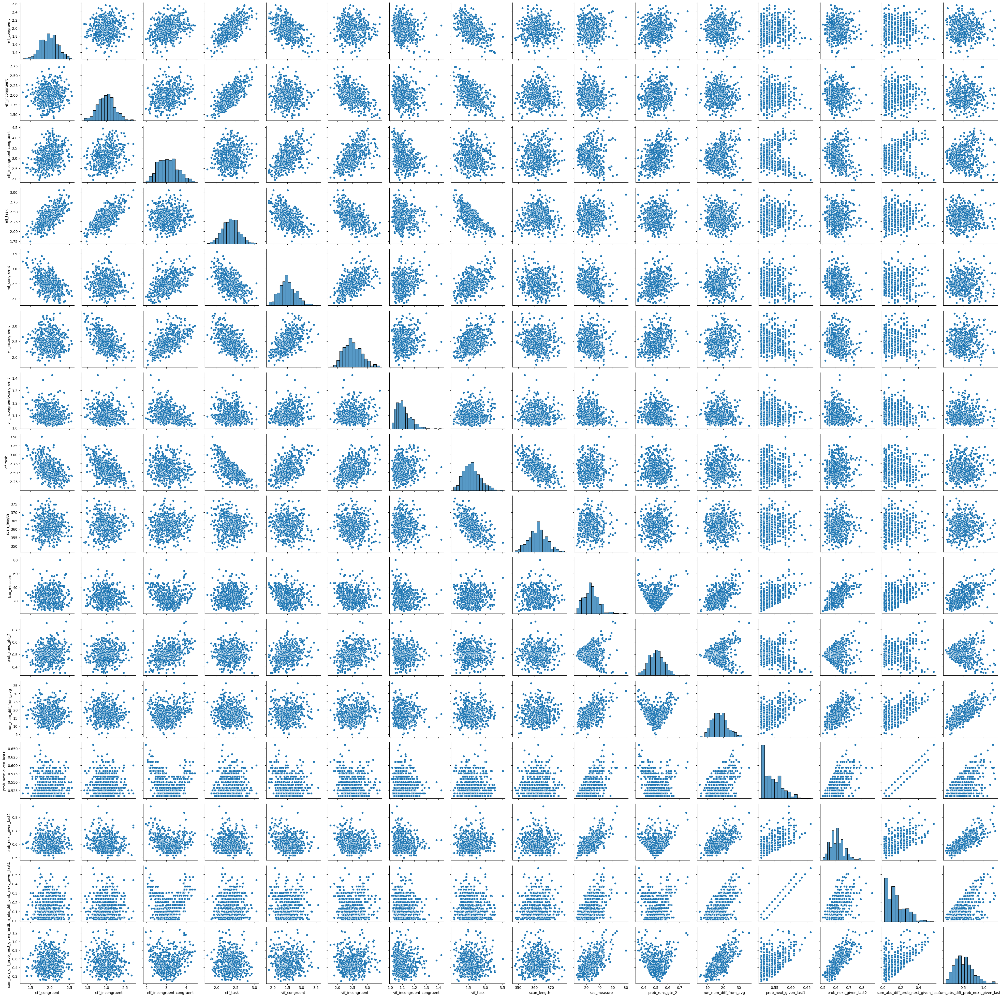

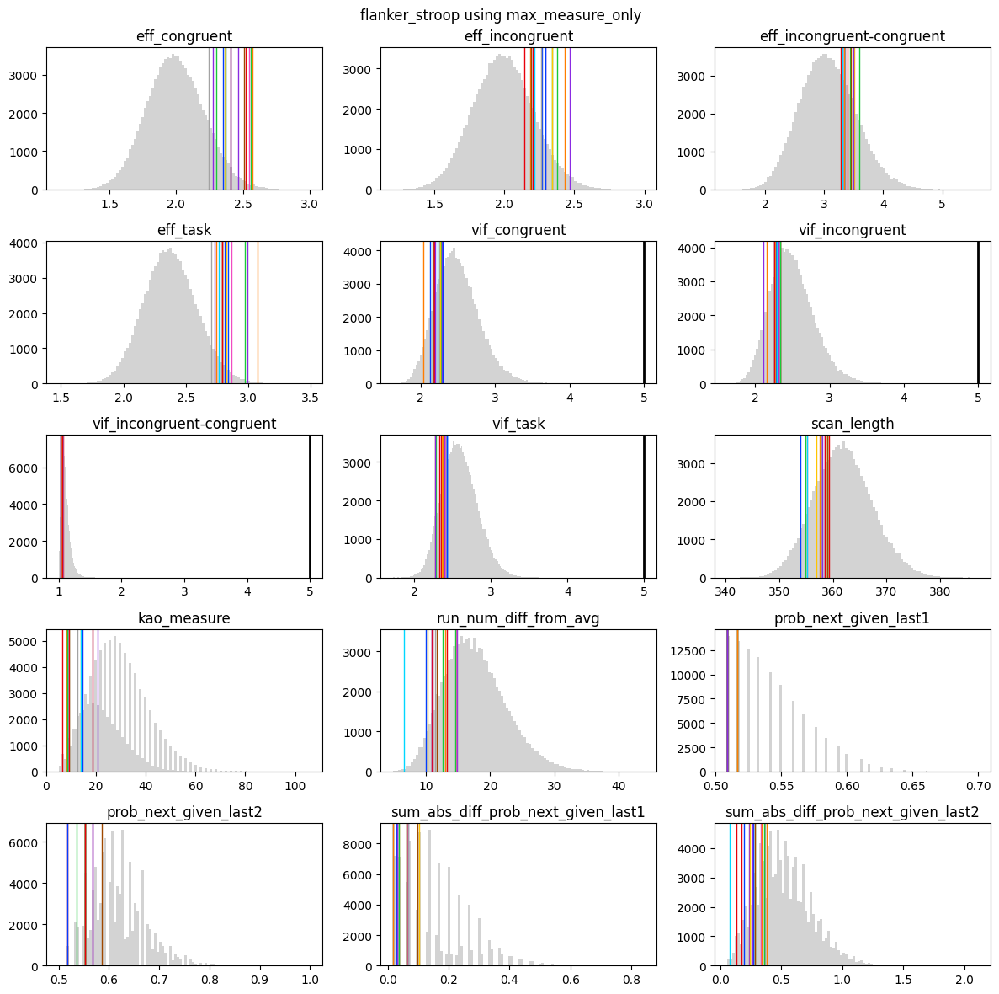

{95424, 865, 4868, 53061, 29126, 48101, 58858, 33050, 1166, 43418, 48151, 9816, 85722, 80573, 63486}


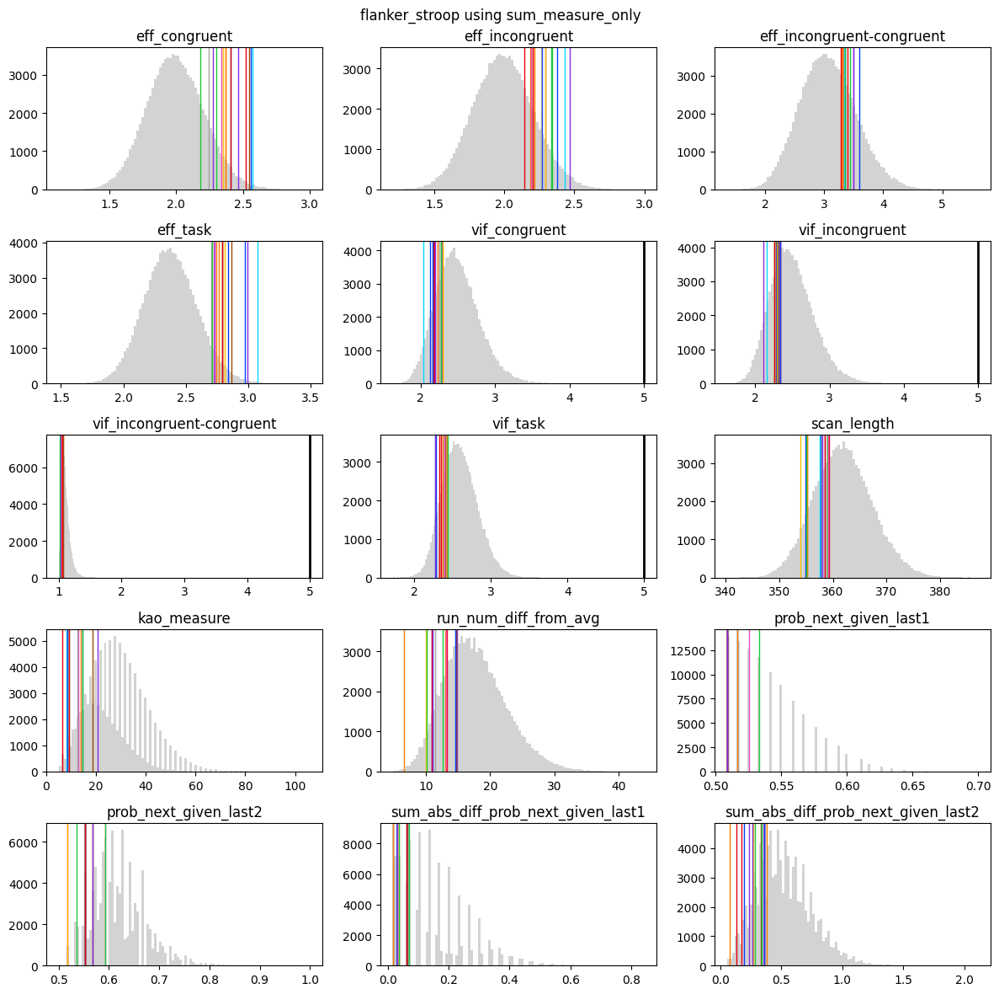

{95424, 865, 4868, 53061, 29126, 58858, 18714, 33050, 48151, 9816, 85722, 43418, 66362, 80573, 63486}


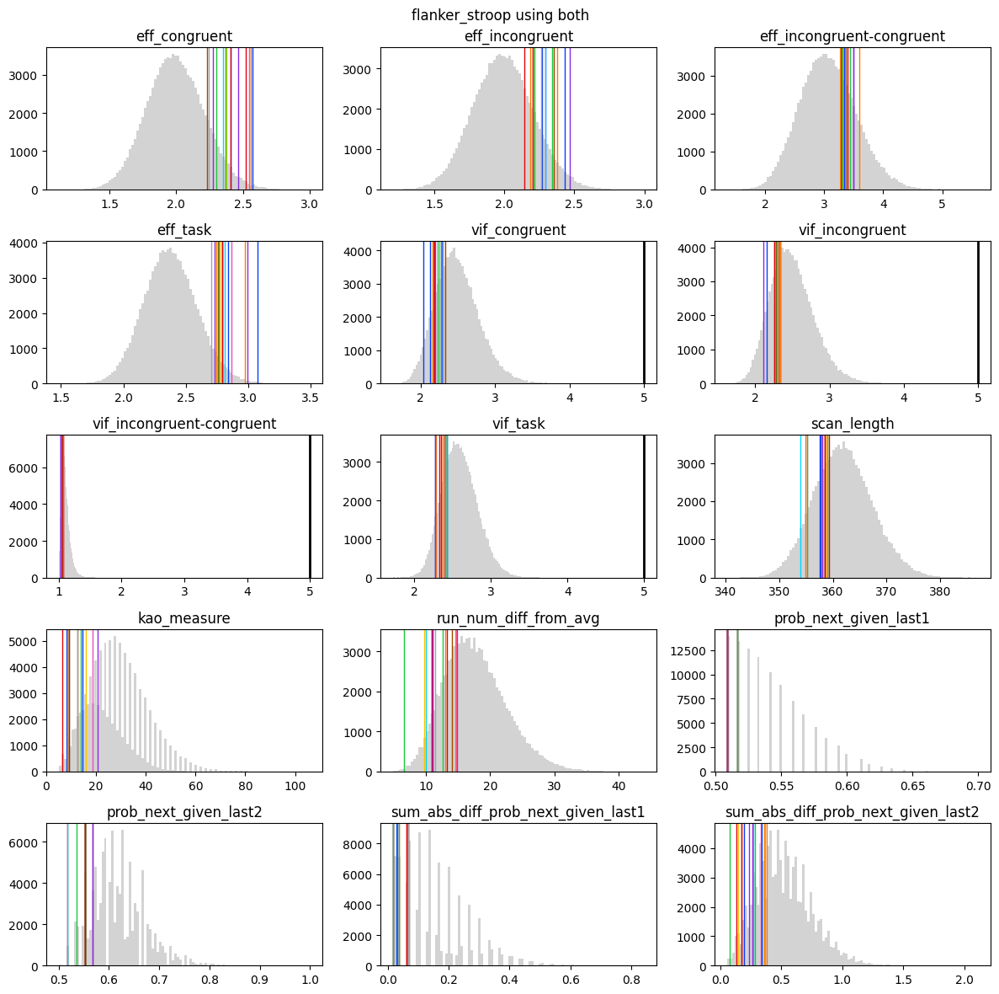

{95424, 865, 4868, 53061, 29126, 27498, 58858, 33050, 36562, 48151, 9816, 85722, 43418, 80573, 63486}


In [8]:
task = 'flanker_stroop'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_flanker_stroop = {}

n_choose = 15

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_flanker_stroop[choice] = choose_designs(output_flanker_stroop, ranks_flanker_stroop, choice, n_choose, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_flanker_stroop[choice] = choose_designs(output_flanker_stroop, ranks_flanker_stroop, choice, n_choose, task, base_psych_meas, make_grid_plot=False)

In [9]:
save_chosen_events_files('flanker_stroop', output_flanker_stroop, events_flanker_stroop, list(overlaps_flanker_stroop['max_measure_only']), root)

## GoNoGo

In [10]:
events_gng, output_gng, ranks_gng = get_events_eff_data(outdir, 'gng')

In [11]:
print(output_gng.shape)

(100000, 16)


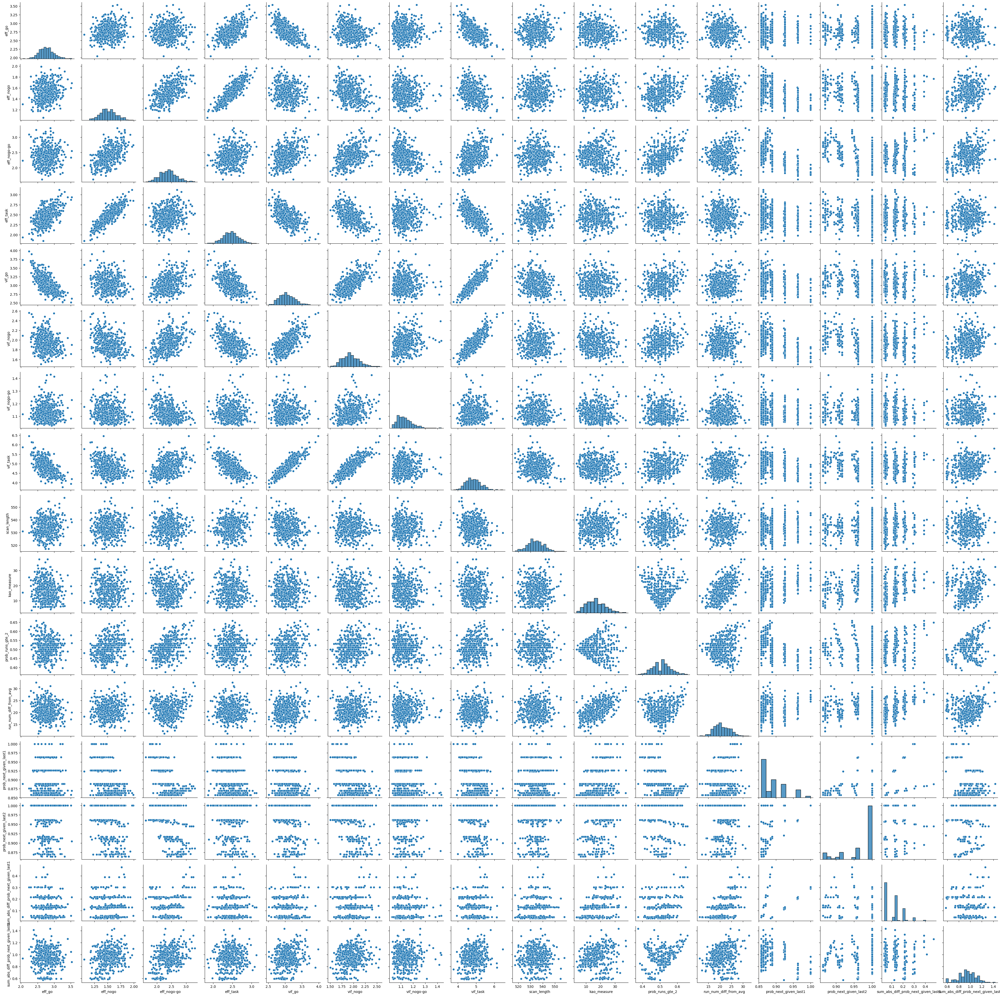

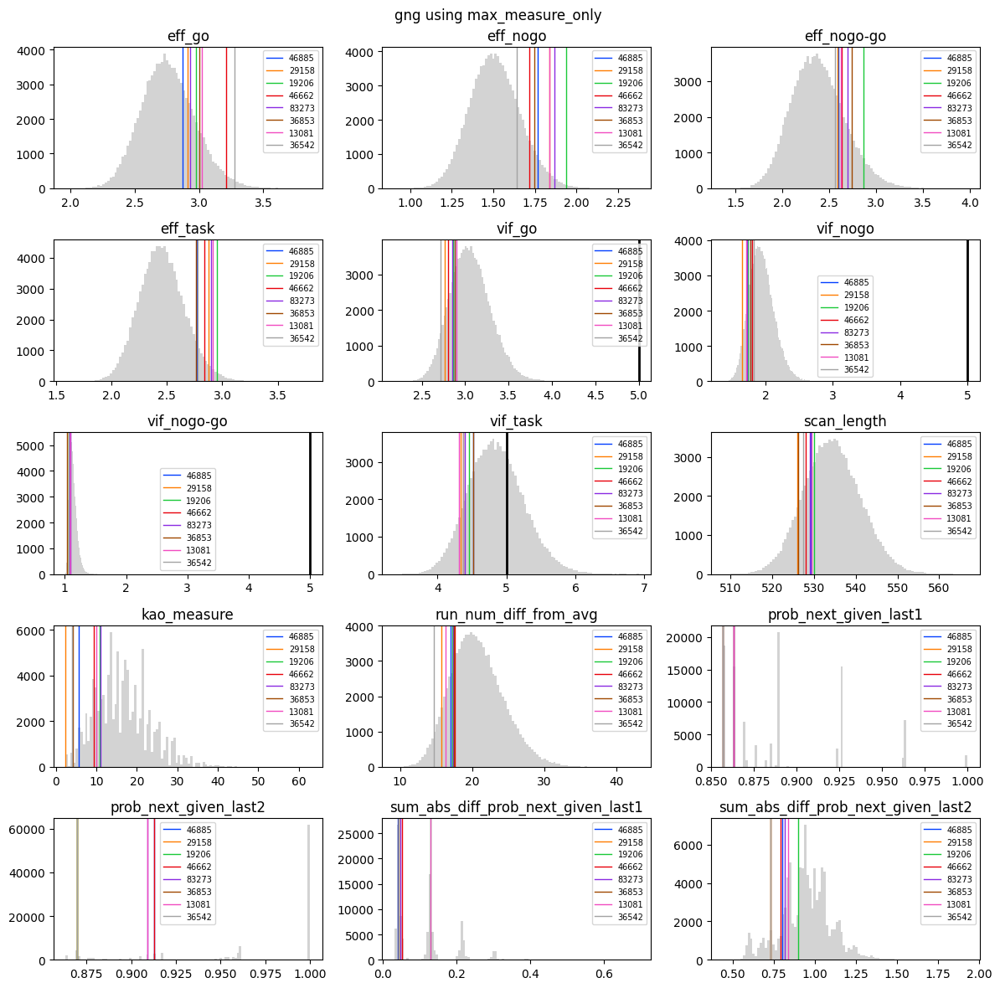

{46885, 29158, 19206, 46662, 83273, 36853, 13081, 36542}


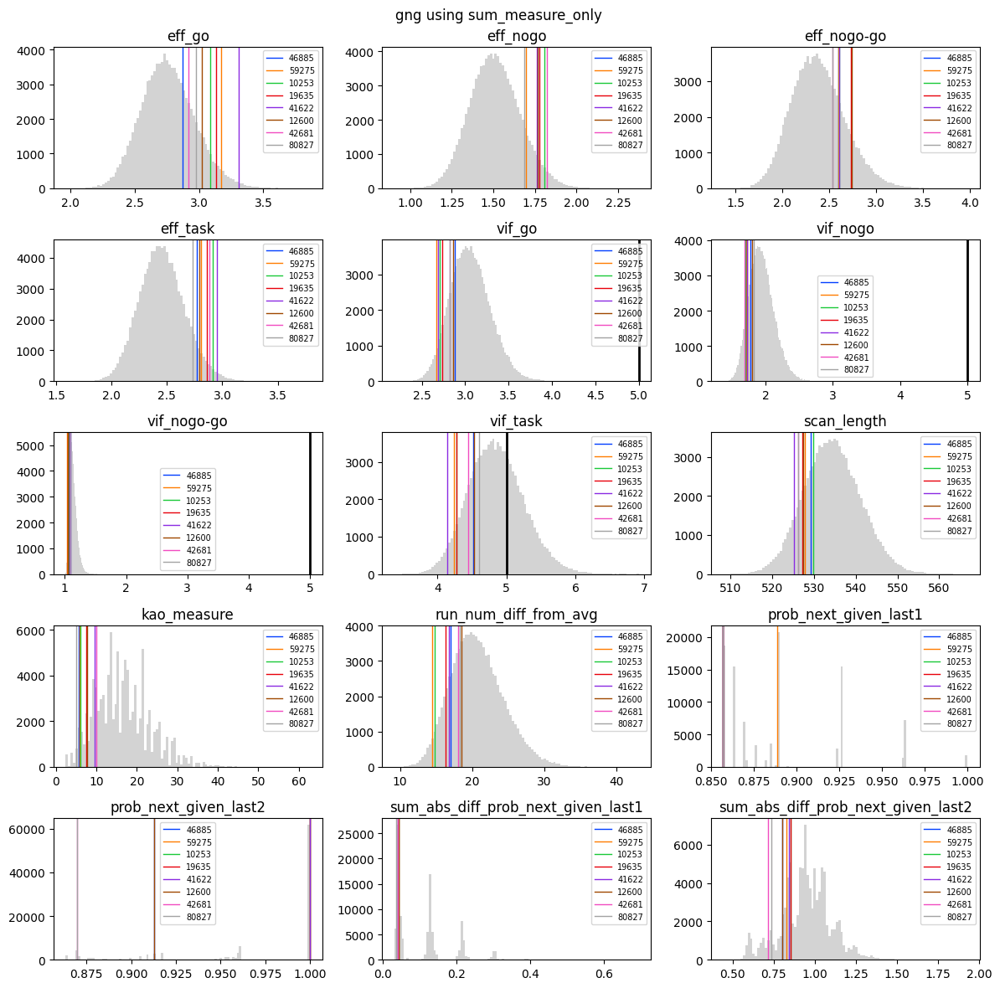

{46885, 59275, 10253, 19635, 41622, 12600, 42681, 80827}


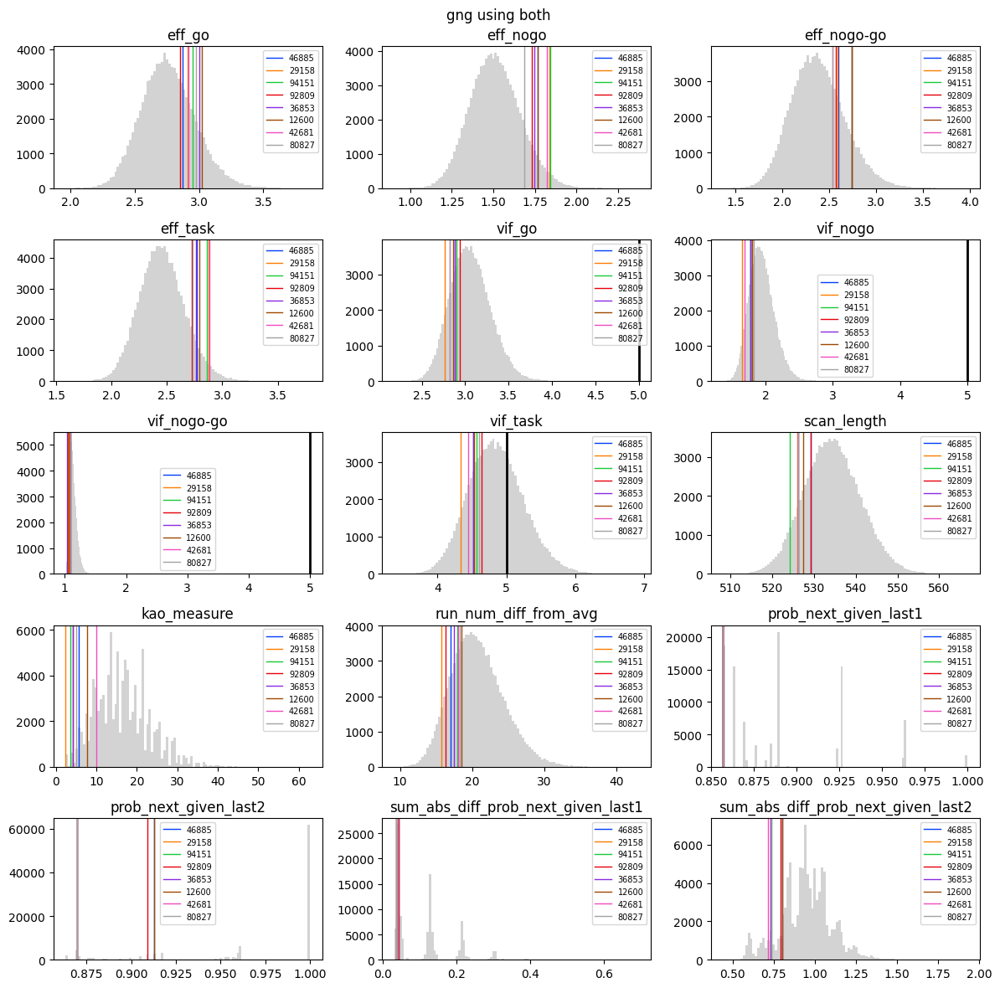

{46885, 29158, 94151, 92809, 36853, 12600, 42681, 80827}


In [12]:
task = 'gng'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_gng = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_gng[choice] = choose_designs(output_gng, ranks_gng, choice, 8, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_gng[choice] = choose_designs(output_gng, ranks_gng, choice, 8, task, base_psych_meas, make_grid_plot=False)


In [13]:

save_chosen_events_files('gng', output_gng, events_gng, list(overlaps_gng['max_measure_only']), root)

## Stop signal

In [14]:
events_stop_signal, output_stop_signal, ranks_stop_signal = get_events_eff_data(outdir, 'stop_signal')

In [15]:
print(output_stop_signal.shape)

(100000, 16)


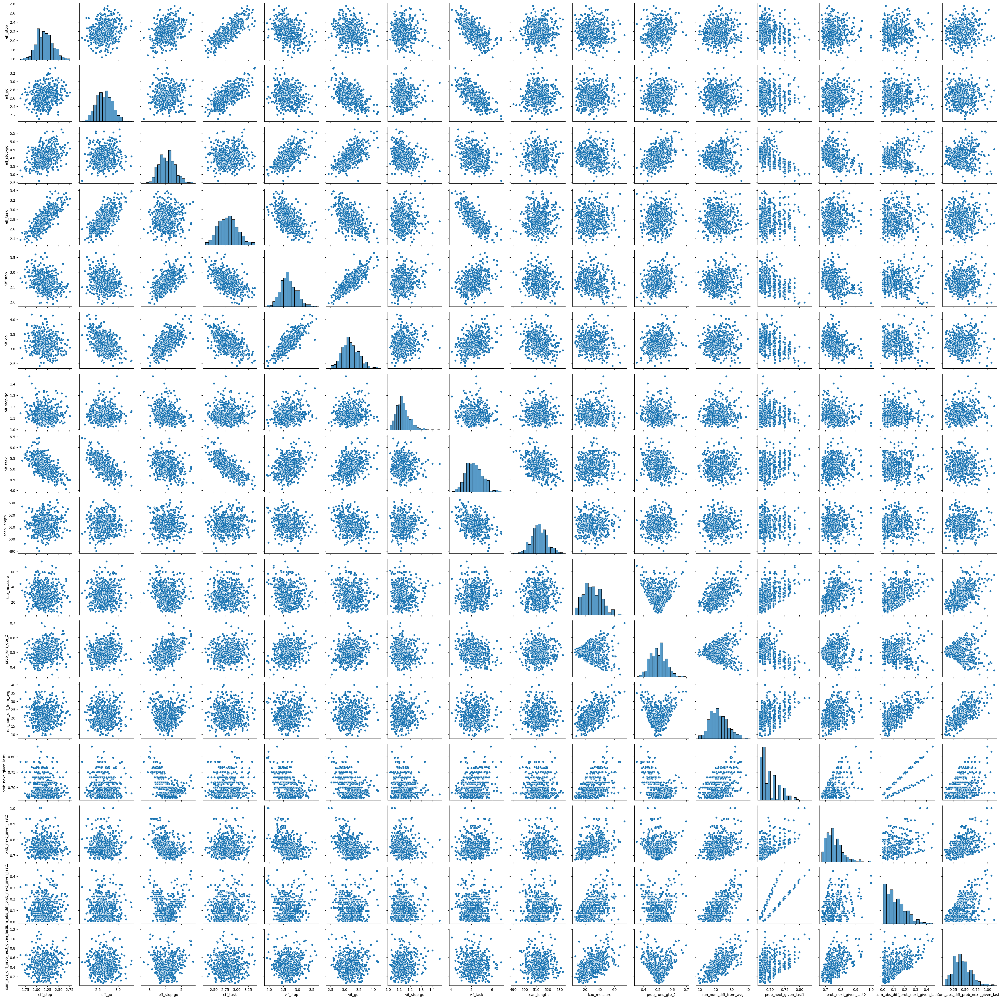

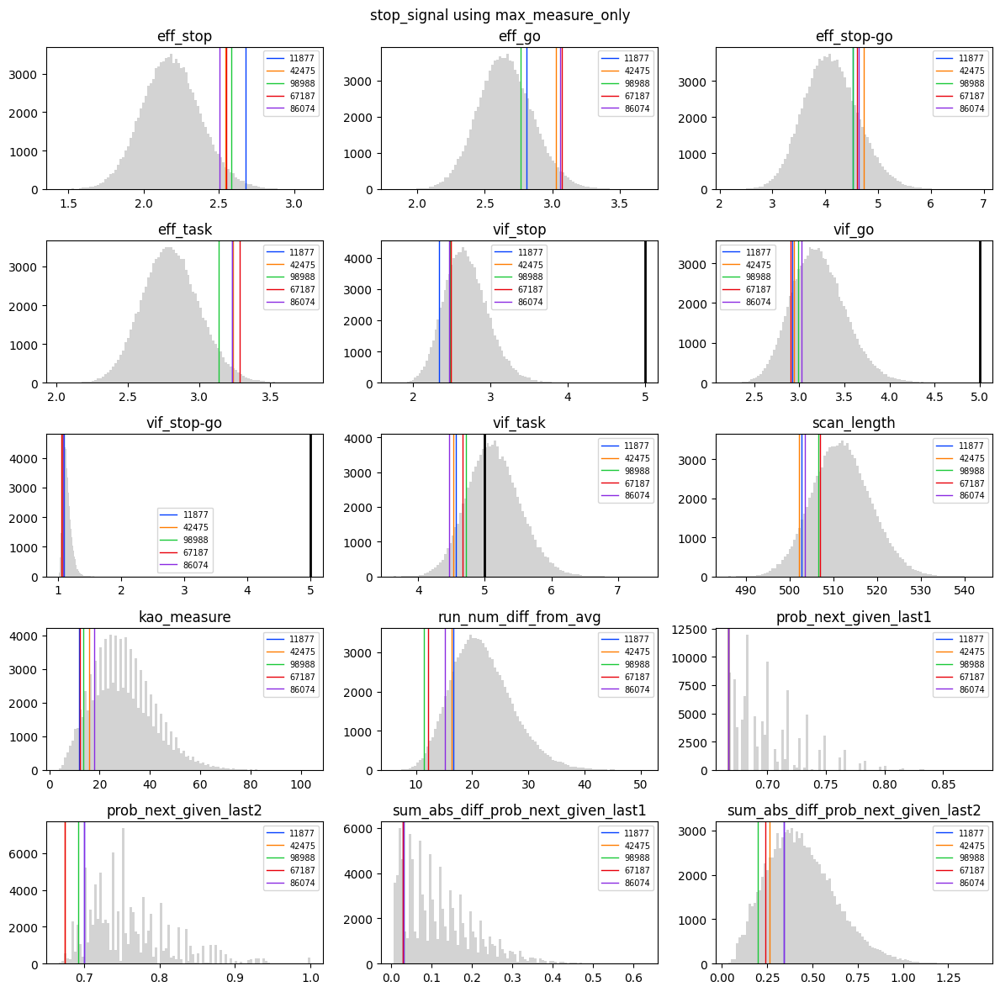

{11877, 42475, 98988, 67187, 86074}


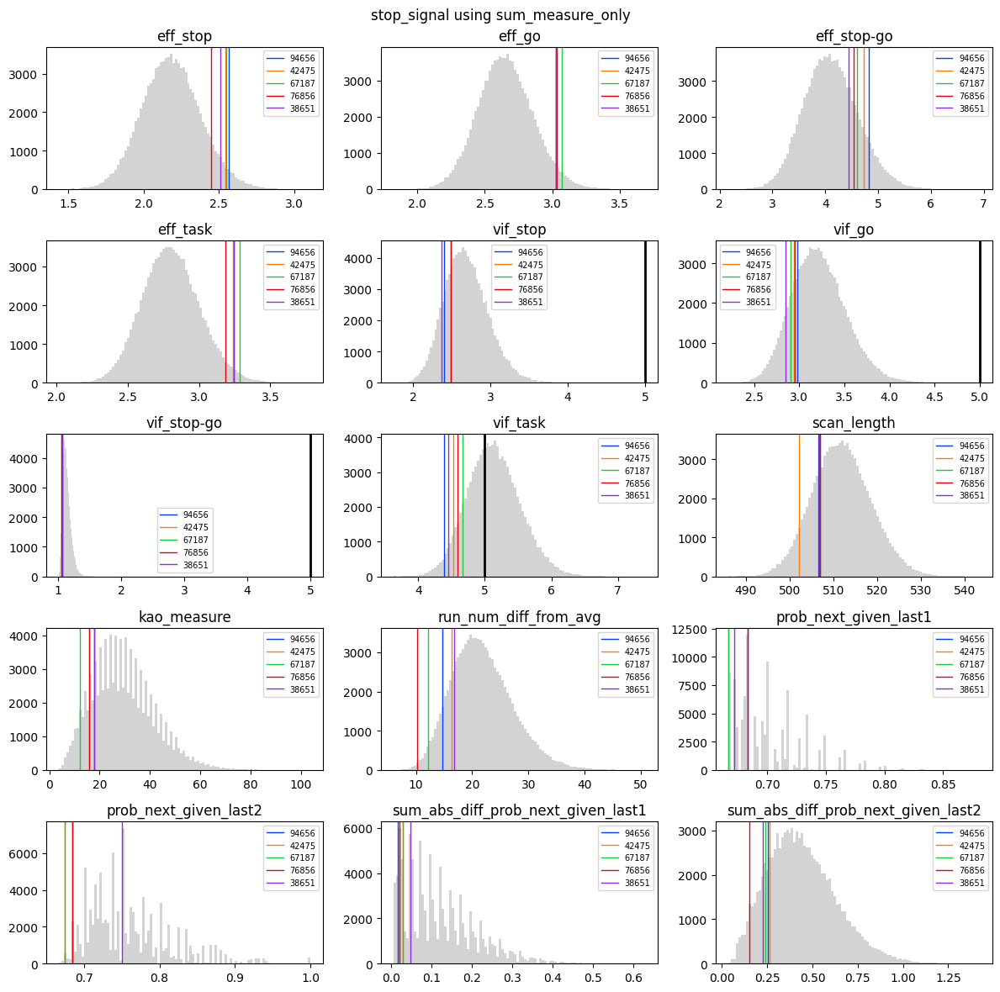

{94656, 42475, 67187, 76856, 38651}


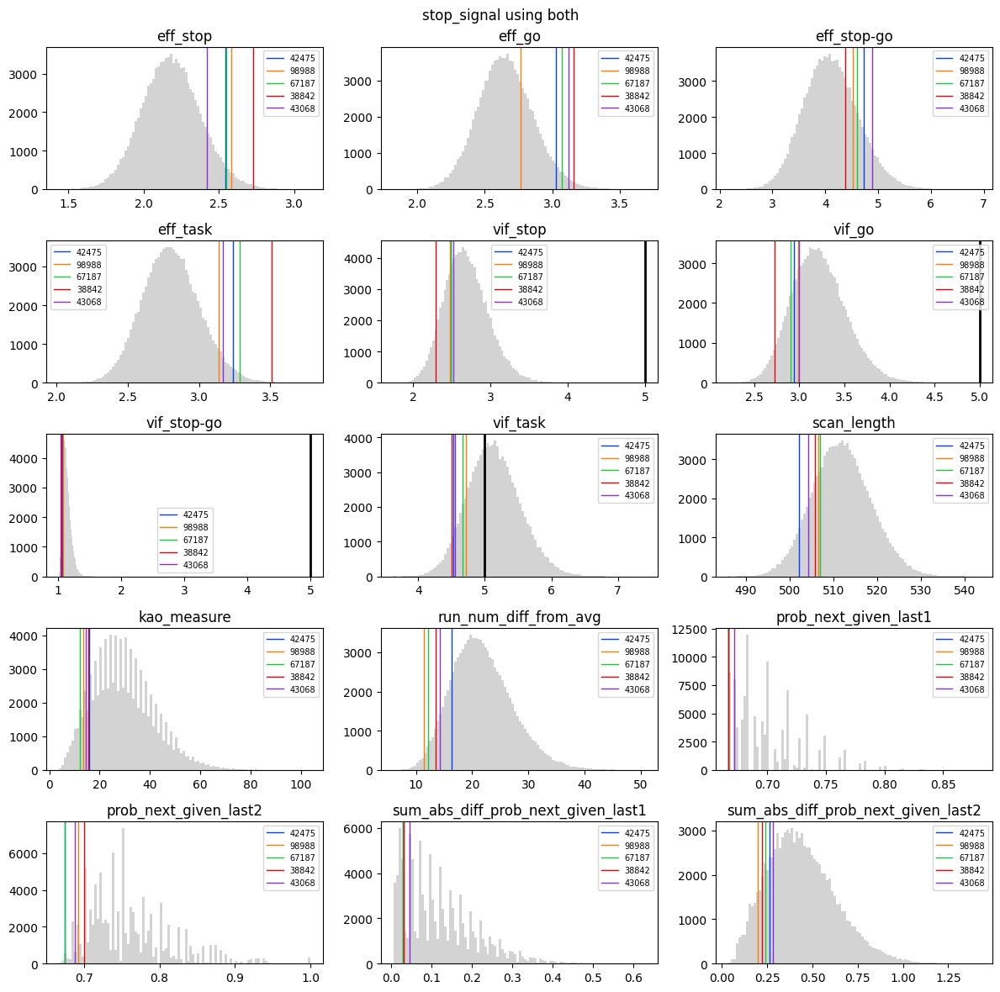

{42475, 98988, 67187, 38842, 43068}


In [16]:
task = 'stop_signal'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_stop_signal = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_stop_signal[choice] = choose_designs(output_stop_signal, ranks_stop_signal, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_stop_signal[choice] = choose_designs(output_stop_signal, ranks_stop_signal, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [17]:
save_chosen_events_files('stop_signal', output_stop_signal, events_stop_signal, list(overlaps_stop_signal['max_measure_only']), root)

## AX CPT

## Changes made for model selection

For AX-CPT, the psychological measures stored are based on treating AX/AY/BX/BY as the four different trial types of interest, but this doesn't control whether or not there are too many, for example, A trials in a row.  What is done here is first 30 good designs are chosen based on the max measure only, using the original 4 trial splits.  Then, on these 30 designs only, new psychological measures are calculated to assess the A/B trial ordering (ignoring X/Y).

In [18]:
events_ax_cpt, output_ax_cpt, ranks_ax_cpt = get_events_eff_data(outdir, 'ax_cpt_ab')

In [19]:
print(output_ax_cpt.shape)

(100000, 20)


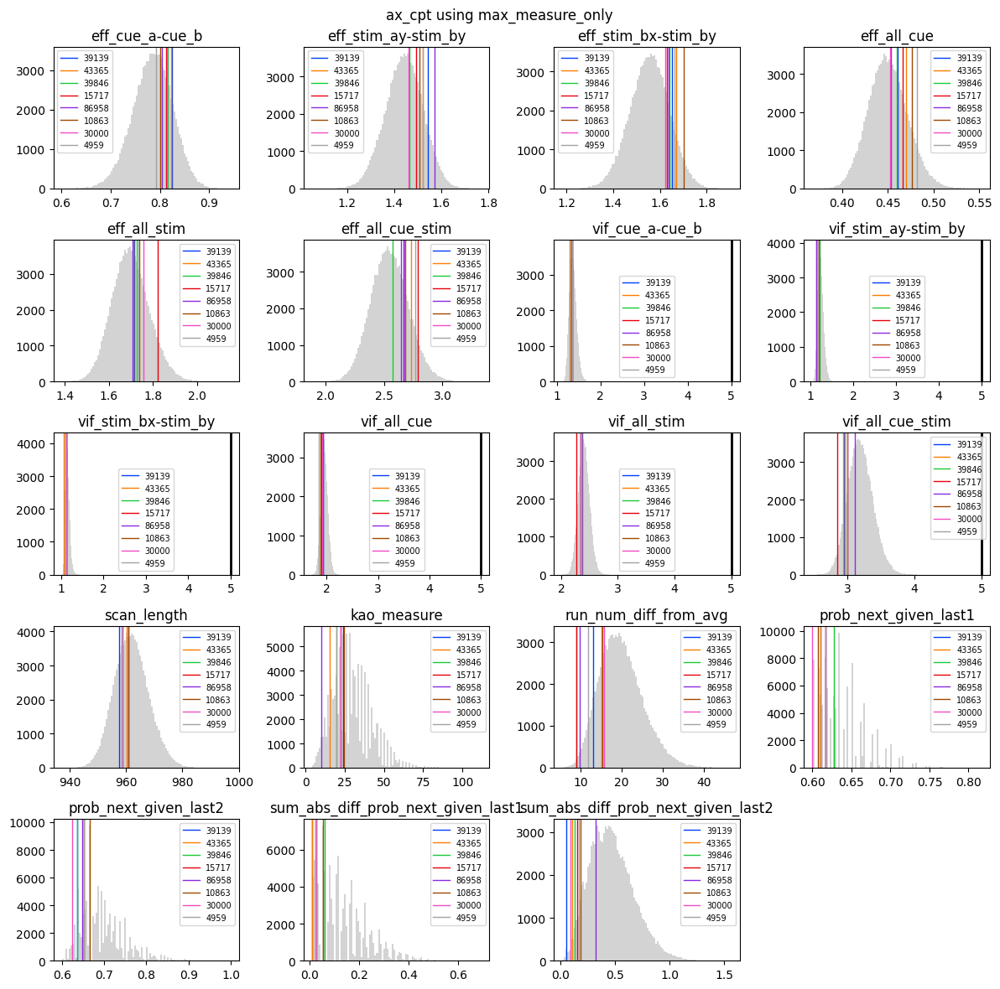

{39139, 43365, 39846, 15717, 86958, 10863, 30000, 4959}


In [20]:
task = 'ax_cpt'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only']
overlaps_ax_cpt = {}

ndesigns = 8

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_ax_cpt[choice] = choose_designs(output_ax_cpt, ranks_ax_cpt, choice, ndesigns, task, base_psych_meas, make_grid_plot=False)
        

In [21]:
save_chosen_events_files('ax_cpt', output_ax_cpt, events_ax_cpt, list(overlaps_ax_cpt['max_measure_only']), root) 

### AX-CPT second option

Here I begin with the original designs, where the psych measures are based on all 4 trial types AX/AY/BX/BY.  I first choose the top 1000 designs using those metrics and within those I do a secondary search based on the A/B labels, alone.

In [22]:
events_ax_cpt_4lev, output_ax_cpt_4lev, ranks_ax_cpt_4lev = get_events_eff_data(outdir, 'ax_cpt')

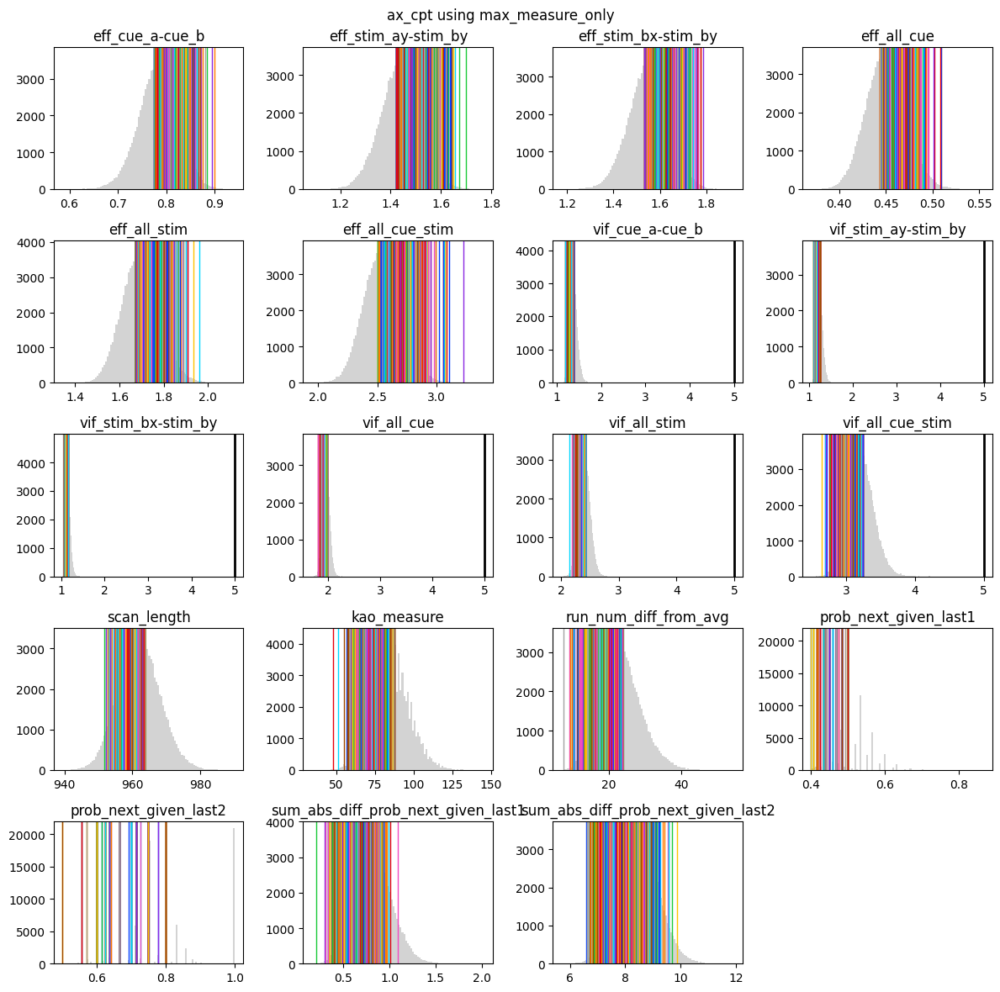

{26626, 59400, 51211, 53264, 2065, 38932, 53273, 49184, 34, 47138, 8228, 73771, 84012, 51, 18485, 26678, 96311, 55352, 45113, 18490, 34874, 55355, 73789, 94269, 73793, 47170, 61511, 92236, 22607, 28753, 55386, 47195, 34909, 14430, 34920, 28780, 61552, 24689, 55416, 55417, 92282, 84092, 90237, 84097, 6278, 92294, 47242, 55437, 75924, 152, 39067, 92315, 94365, 82079, 39077, 49322, 4269, 37038, 80056, 41148, 43198, 20670, 8389, 59591, 51400, 12489, 75981, 92367, 53465, 67803, 24796, 86242, 26851, 28904, 43252, 73973, 55549, 6398, 92419, 30987, 55572, 8471, 92446, 71973, 96557, 4399, 31024, 53552, 86321, 84275, 307, 67896, 24891, 53564, 57666, 76113, 96594, 78186, 33133, 74097, 63865, 65914, 16763, 27004, 96637, 55675, 86402, 20867, 6539, 396, 53649, 2455, 4507, 57763, 45479, 37288, 94640, 72116, 29113, 92613, 61893, 22982, 80328, 10697, 88518, 45515, 94670, 78292, 53720, 37344, 94694, 59886, 41456, 14833, 76274, 31228, 43517, 4605, 47616, 90628, 10766, 59929, 86554, 31262, 29215, 6692, 46

In [23]:
# Choose top 500, using ax/ay/bx/by trial type split
task = 'ax_cpt'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only']
overlaps_ax_cpt_4lev = {}

ndesigns = 500

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_ax_cpt_4lev[choice] = choose_designs(output_ax_cpt_4lev, ranks_ax_cpt_4lev, choice, ndesigns, task, base_psych_meas, make_grid_plot=False)
        

In [24]:
trials_psych_assess_map = {'stim_ax': '1', 'stim_ay': '1', 'stim_bx': '2', 'stim_by': '2'}

events_inputs_delay_jitter_no_deriv = {
    'n_ax': 60,
    'n_ay': 30,
    'n_bx': 30,
    'n_by': 30,
    'nbreaks': 2,
    'cue_dur': .5,
    'delay_dur': 'jittered3',
    'stim_dur': 1,
    'blank_dur': .5,
    'break_fix_pre_message_dur': 6,
    'break_message_dur': 4,
    'break_fix_post_message_dur': 6,
    'isi_exp_lam': 2,
    'isi_truncation': 4.5,
    'isi_shift': .5
}

unpermuted_trials = np.concatenate([np.repeat('1', events_inputs_delay_jitter_no_deriv['n_ax']/3), 
                                    np.repeat('1', events_inputs_delay_jitter_no_deriv['n_ay']/3),
                                    np.repeat('2', events_inputs_delay_jitter_no_deriv['n_bx']/3), 
                                    np.repeat('2', events_inputs_delay_jitter_no_deriv['n_by']/3)],
                                    axis=0)
avg_trial_repeats_info = calc_expected_run_num_by_chance(unpermuted_trials, nsims=5000)
for val in ['1', '2']:
    avg_trial_repeats_info[f'{val}_run_counts'] = avg_trial_repeats_info[f'{val}_run_counts'] * 3        
avg_prob_given_last1, avg_prob_given_last2 = calc_avg_prob_next_given_last1_and_last2(unpermuted_trials)


In [25]:

# Set up output
contrasts = {'cue_a-cue_b': 'cue_a - cue_b',
            'stim_ay-stim_by': 'stim_ay-stim_by',
            'stim_bx-stim_by': 'stim_bx-stim_by',
            'all_cue': '.5*cue_a + .5*cue_b',
            'all_stim': '.25*stim_ax + .25*stim_ay + .25*stim_bx + .25*stim_by',
            'all_cue_stim': '1/6*cue_a +  1/6*cue_b + 1/6*stim_ax + 1/6*stim_ay + 1/6*stim_bx + 1/6*stim_by'
            }
psych_variables = ['kao_measure', 'prob_runs_gte_2', 'run_num_diff_from_avg',
                    'prob_next_given_last1', 'prob_next_given_last2',
                    'sum_abs_diff_prob_next_given_last1', 'sum_abs_diff_prob_next_given_last2']
output_ab = {f'eff_{contrast_name}':[] for contrast_name in contrasts.keys()}
for contrast_name in contrasts.keys():
    output_ab[f'vif_{contrast_name}'] = [] 
output_ab['scan_length'] = []
for var in psych_variables:
    output_ab[var] = []
output_ab['design_index'] = []


for index in overlaps_ax_cpt_4lev['max_measure_only']:
    events = events_ax_cpt_4lev[index]
    output_ab['design_index'].append(index)
    trials_psych_assess = events['trial_type'][events['trial_type'].isin(trials_psych_assess_map)]
    trials_psych_assess_coded = np.array(trials_psych_assess.replace(trials_psych_assess_map))
    psych_assess = est_psych_fitness(trials_psych_assess_coded, avg_trial_repeats_info, 
                                        avg_prob_given_last1, avg_prob_given_last2)
    for key, val in psych_assess.items():
        output_ab[key].append(val)
    for key in output_ab.keys():
        if 'eff' in key:
            output_ab[key].append(output_ax_cpt_4lev[key][index]) 
        if 'vif' in key:
            output_ab[key].append(output_ax_cpt_4lev[key][index])  
        if 'scan_length' in key:
            output_ab[key].append(output_ax_cpt_4lev['scan_length'][index])

output_ab_df = pd.DataFrame(output_ab)
ranks_ab = {col: np.argsort(output_ab_df[col].to_numpy()) for col in output_ab_df.columns}


# The values in rank_ab refer to the row numbers in output_ab_df and I'd like that to instead be the row numbers in output_ax_cpt

translate_ab_index_to_original_index = {}
for i, index in enumerate(output_ab_df['design_index']):
    translate_ab_index_to_original_index[i] = index

ranks_ab_orig_order = {}
for key in ranks_ab.keys():
    ranks_ab_orig_order[key] = [translate_ab_index_to_original_index[i] for i in ranks_ab[key]]

output_ab_df2 = output_ab_df.set_index(output_ab_df['design_index'].copy().values)



In [26]:
len(ranks_ab_orig_order['eff_cue_a-cue_b'])

500

In [27]:
output_ab_df2.index

Index([26626, 59400, 51211, 53264,  2065, 38932, 53273, 49184,    34, 47138,
       ...
        1991, 94152, 73683, 73684, 16346, 83930, 67555, 79853, 20462, 18426],
      dtype='int64', length=500)

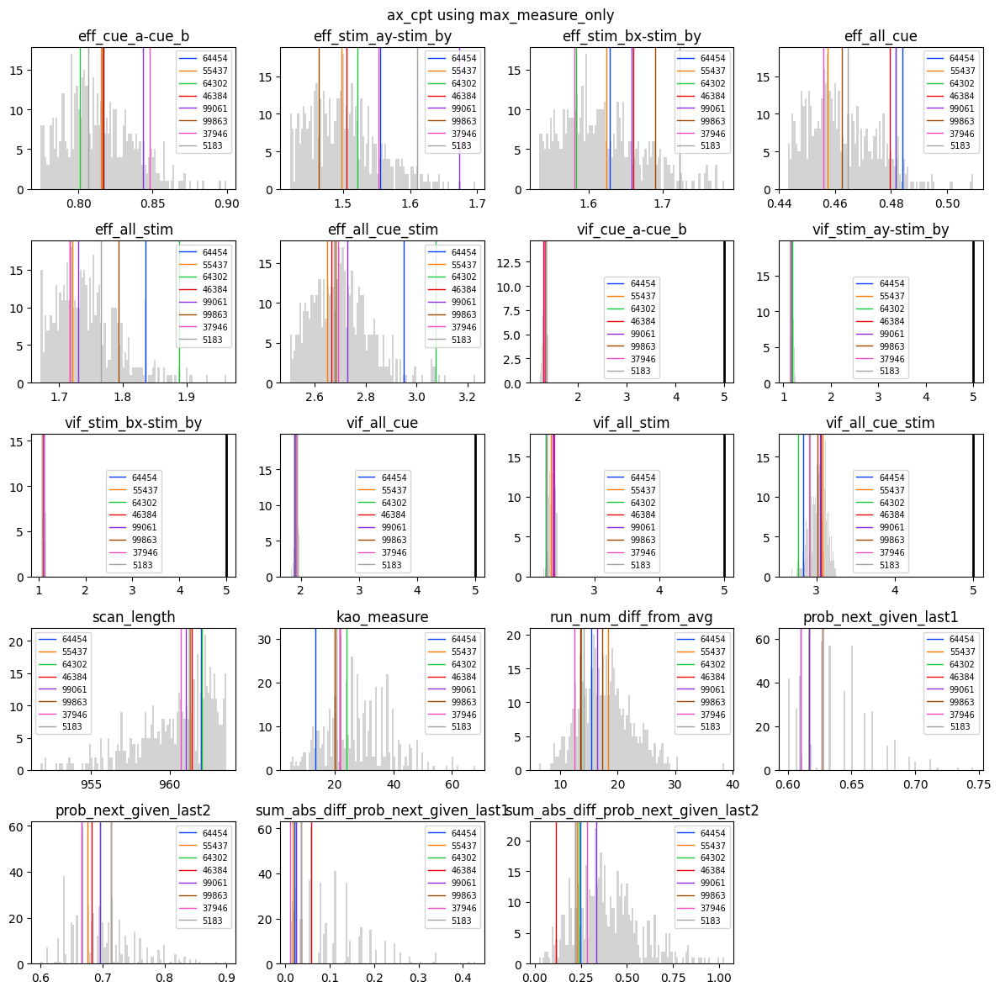

{64454, 55437, 64302, 46384, 99061, 99863, 37946, 5183}


In [28]:
# now choose top 10 from the top 30, but now using the A/B trial type split
task = 'ax_cpt'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only']
overlaps_ax_cpt = {}

ndesigns = 8

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_ax_cpt[choice] = choose_designs(output_ab_df2, ranks_ab_orig_order, choice, ndesigns, task, base_psych_meas, make_grid_plot=False)

In [29]:
save_chosen_events_files('ax_cpt_4lev_first_2lev_second', output_ab_df2, events_ax_cpt_4lev, list(overlaps_ax_cpt['max_measure_only']), root) 

## Cued TS and Spatial TS

In [30]:
events_cued_ts_spatial_ts, output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts = get_events_eff_data(outdir, 'cued_ts_spatial_ts')

In [31]:
print(output_cued_ts_spatial_ts.shape)

(100000, 14)


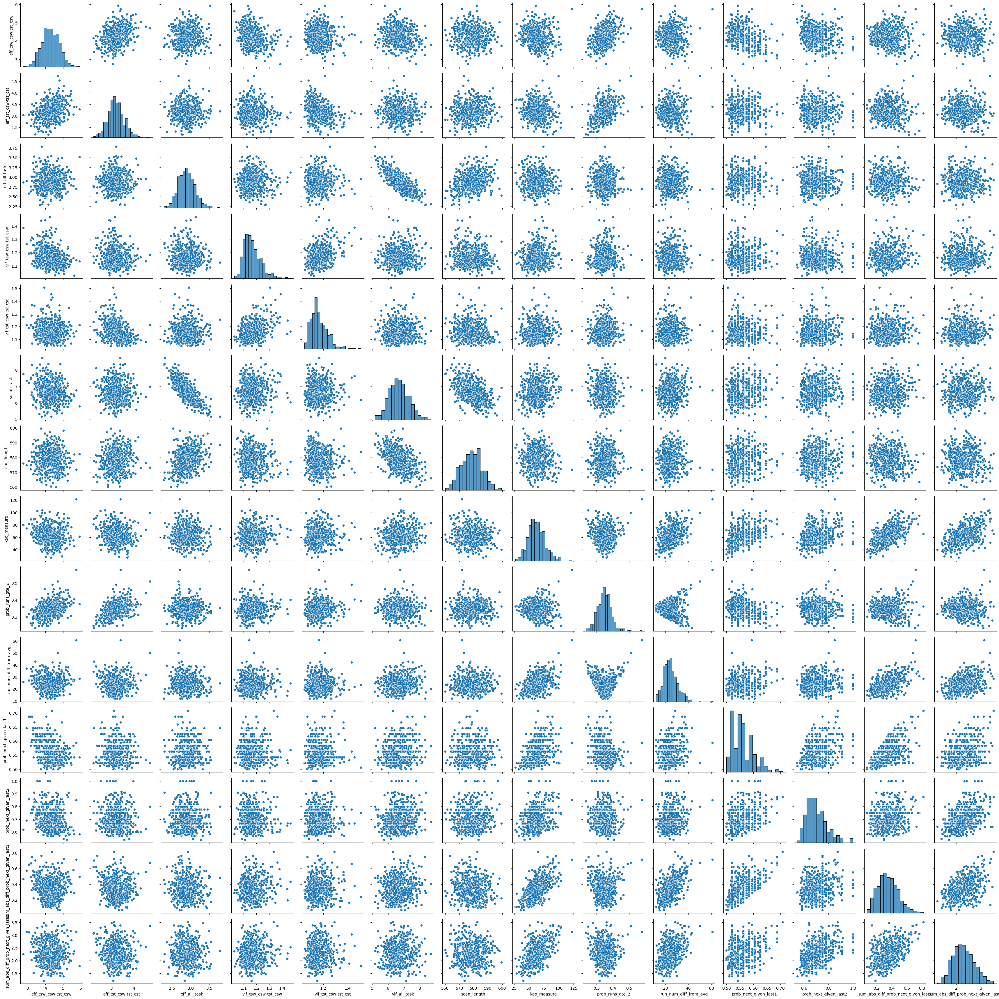

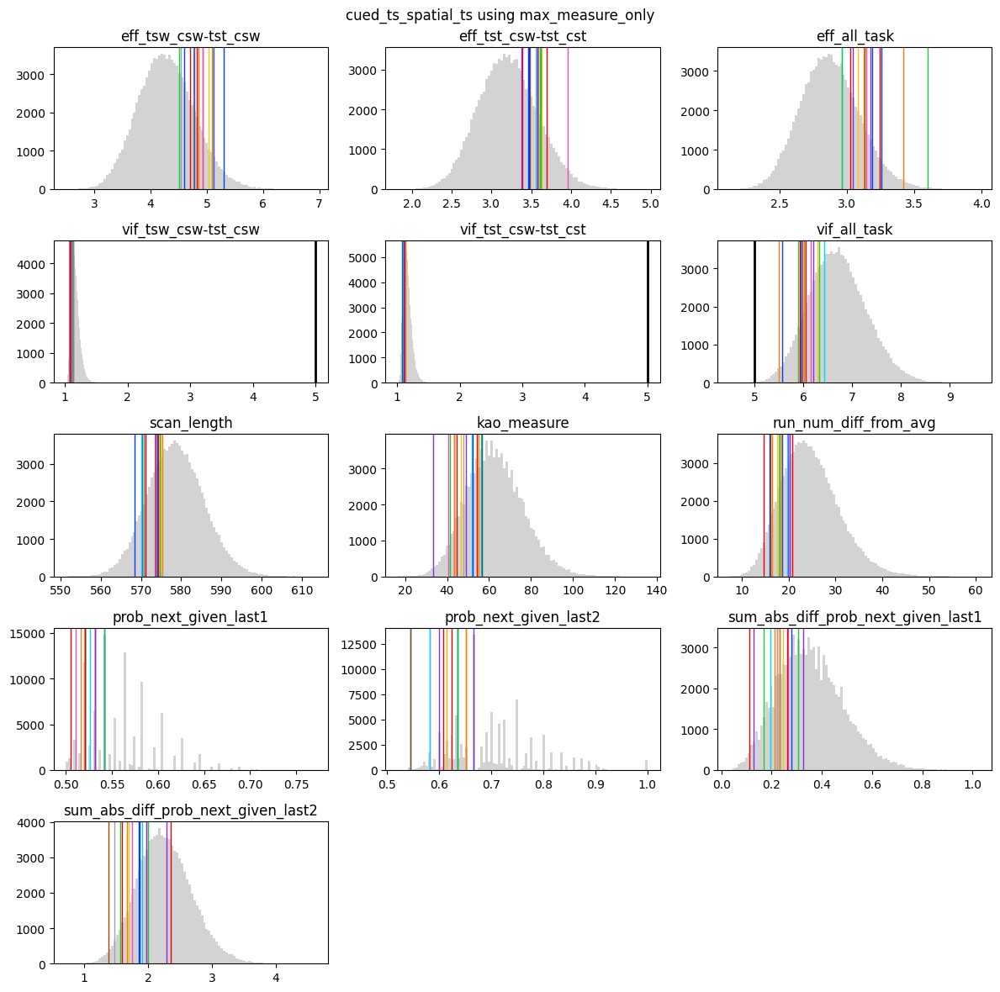

{70373, 61880, 32808, 41001, 13450, 24587, 65419, 28591, 12879, 55253, 15797, 92021, 54200, 56889, 33557}


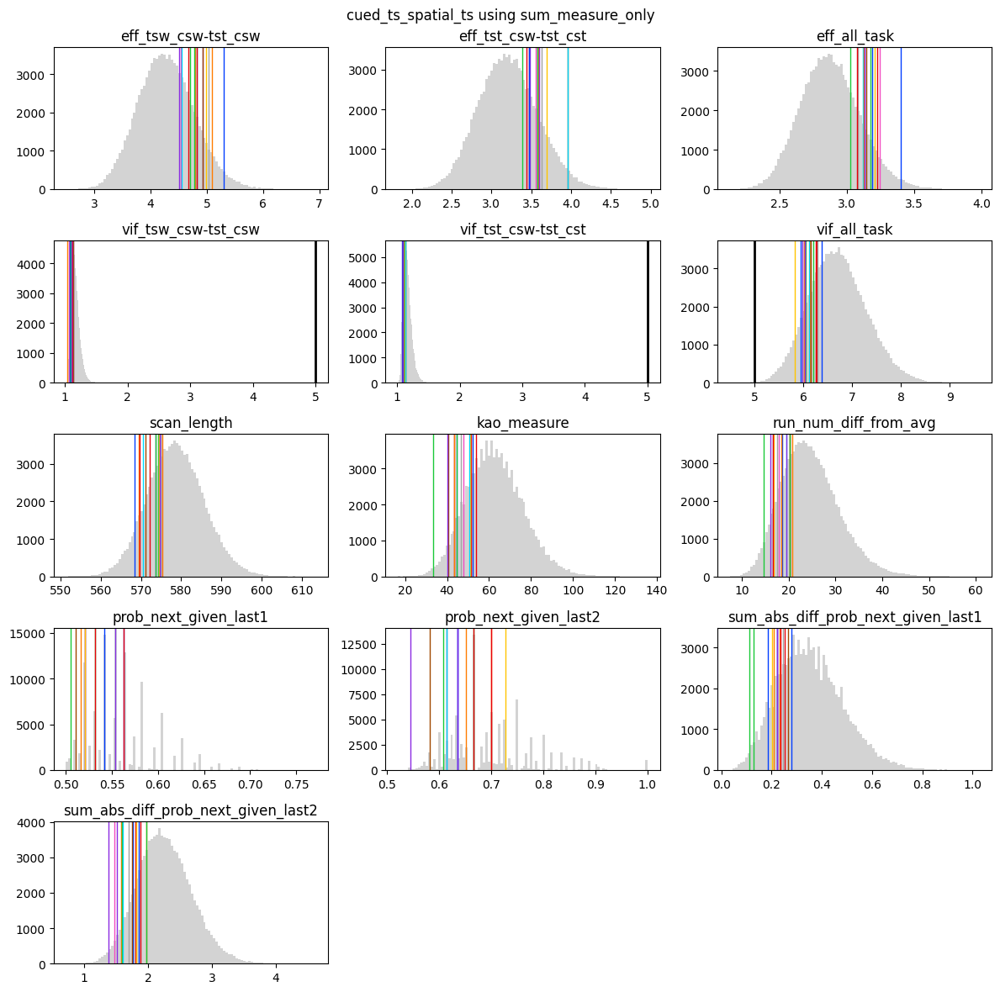

{76807, 2312, 41001, 92104, 24587, 65419, 28591, 12879, 74514, 38164, 15797, 92021, 33557, 98425, 67871}


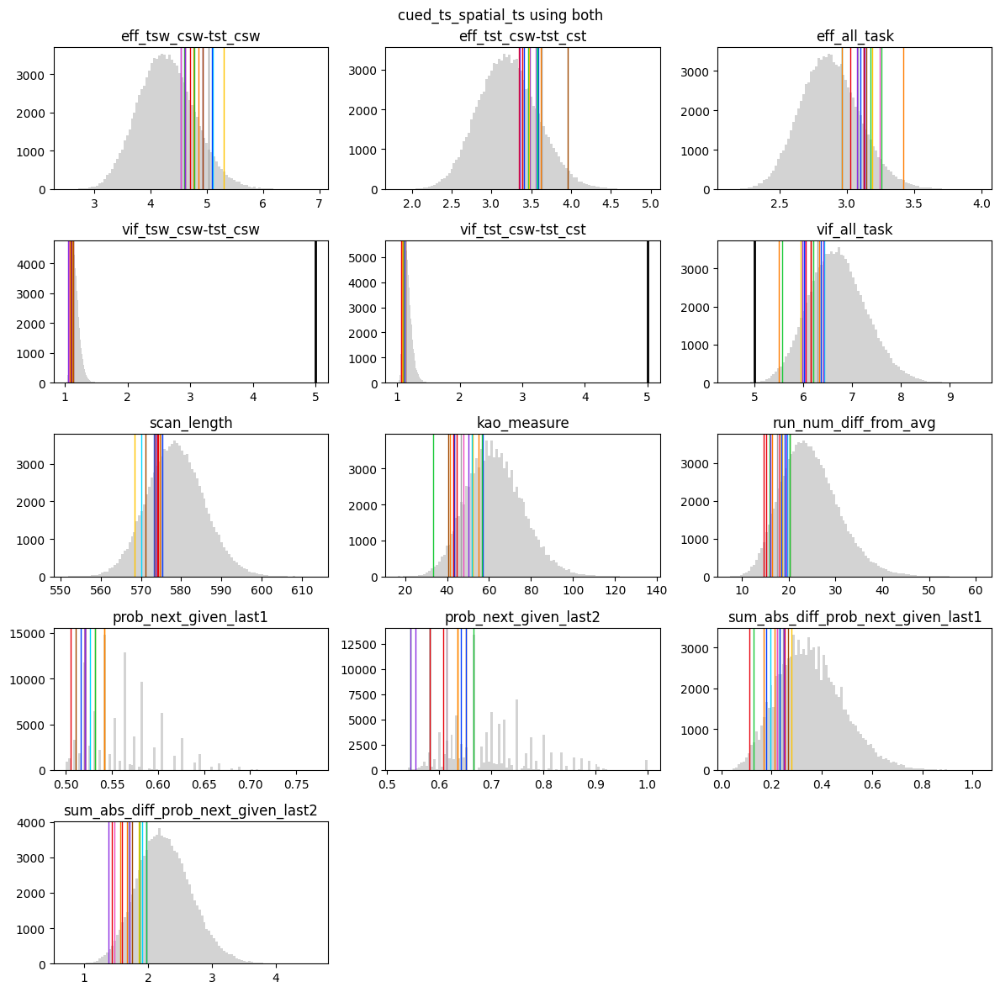

{36709, 61880, 70373, 41001, 24587, 65419, 28591, 12879, 15797, 55253, 92021, 54200, 33557, 11324, 19455}


In [32]:
task = 'cued_ts_spatial_ts'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_cued_ts_spatial_ts = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_cued_ts_spatial_ts[choice] = choose_designs(output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts, choice, 15, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_cued_ts_spatial_ts[choice] = choose_designs(output_cued_ts_spatial_ts, ranks_cued_ts_spatial_ts, choice, 15, task, base_psych_meas, make_grid_plot=False)

In [33]:
print(list(overlaps_cued_ts_spatial_ts['max_measure_only']))

[70373, 61880, 32808, 41001, 13450, 24587, 65419, 28591, 12879, 55253, 15797, 92021, 54200, 56889, 33557]


In [34]:
output_cued_ts_spatial_ts.loc[list(overlaps_cued_ts_spatial_ts['max_measure_only']), :]

,eff_tsw_csw-tst_csw,eff_tst_csw-tst_cst,eff_all_task,vif_tsw_csw-tst_csw,vif_tst_csw-tst_cst,vif_all_task,scan_length,kao_measure,prob_runs_gte_2,run_num_diff_from_avg,prob_next_given_last1,prob_next_given_last2,sum_abs_diff_prob_next_given_last1,sum_abs_diff_prob_next_given_last2
70373,4.591634,3.456601,3.258857,1.111442,1.114560,5.559896,574.083035,56.500,0.370690,15.8484,0.520833,0.545455,0.231053,1.861739
61880,4.854843,3.581714,3.422006,1.120668,1.129239,5.504819,573.454464,54.875,0.369748,16.5016,0.531915,0.652174,0.210461,1.673683
32808,4.513514,3.609754,3.597862,1.078051,1.106611,5.888210,570.768652,56.125,0.382609,18.1298,0.520833,0.636364,0.305449,1.996215
41001,4.701207,3.390793,3.028116,1.121694,1.095027,6.053237,574.334295,44.750,0.372881,14.7416,0.505263,0.608696,0.110352,1.593201
13450,5.119128,3.375055,3.047619,1.070063,1.101138,5.938052,570.269078,49.000,0.316667,19.8052,0.531250,0.600000,0.324309,2.290152
24587,4.929484,3.482541,3.135763,1.123934,1.085505,5.972739,573.558219,43.250,0.333333,16.1070,0.520833,0.545455,0.220869,1.382149
65419,4.923092,3.959563,3.147530,1.122805,1.127284,6.152266,571.039522,40.750,0.382609,20.2040,0.510638,0.583333,0.264461,1.745229
28591,4.542916,3.557653,3.247723,1.062408,1.115306,6.036279,574.973680,47.750,0.352941,17.9150,0.520833,0.615385,0.222759,1.465399
12879,5.035910,3.628806,3.082014,1.088891,1.128236,6.289634,574.796024,46.500,0.379310,17.5504,0.520833,0.615385,0.245615,1.694850
55253,5.110448,3.564499,2.966498,1.103271,1.124287,6.431350,570.106798,51.625,0.370690,19.7272,0.526316,0.583333,0.194124,1.911228


In [35]:
save_chosen_events_files('cued_ts_spatial_ts', output_cued_ts_spatial_ts, events_cued_ts_spatial_ts, 
                         list(overlaps_cued_ts_spatial_ts['max_measure_only']), root)

## Nback

In [36]:
events_nback, output_nback, ranks_nback = get_events_eff_data(outdir, 'nback')
print(output_nback.shape)

(100000, 16)


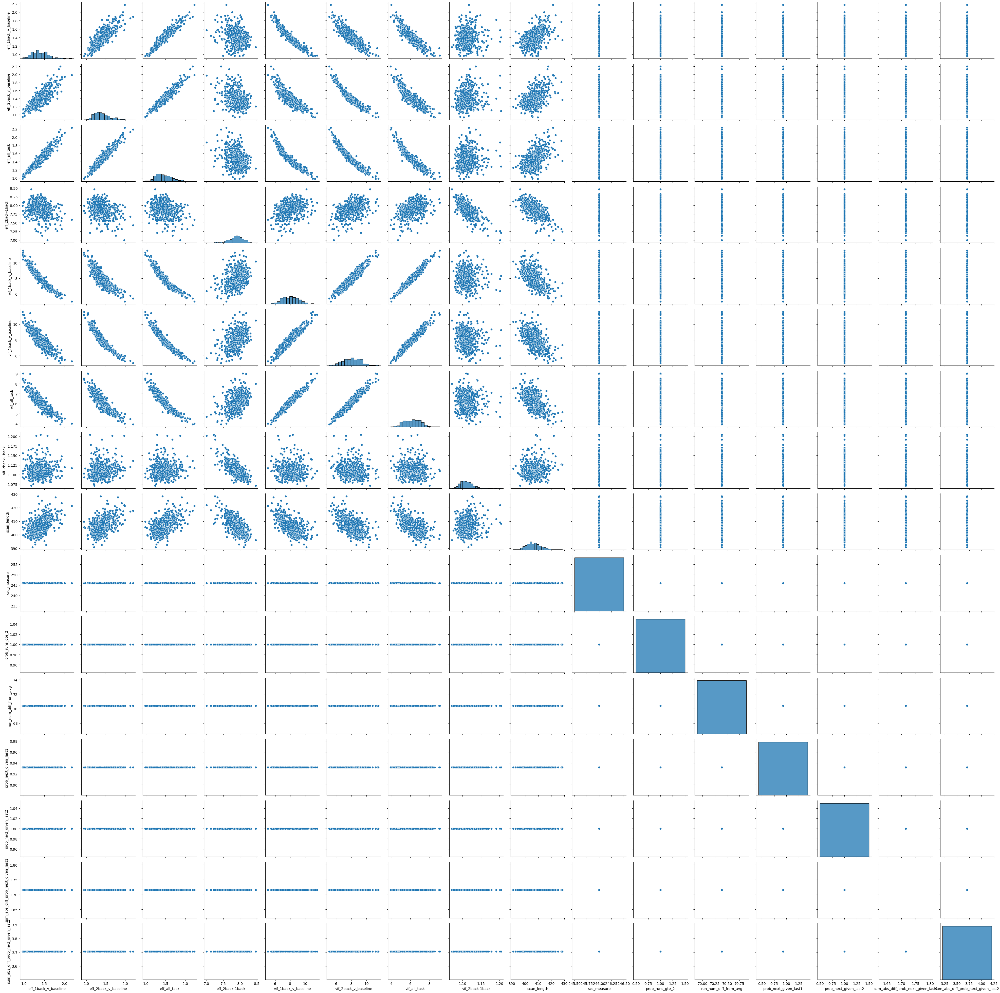

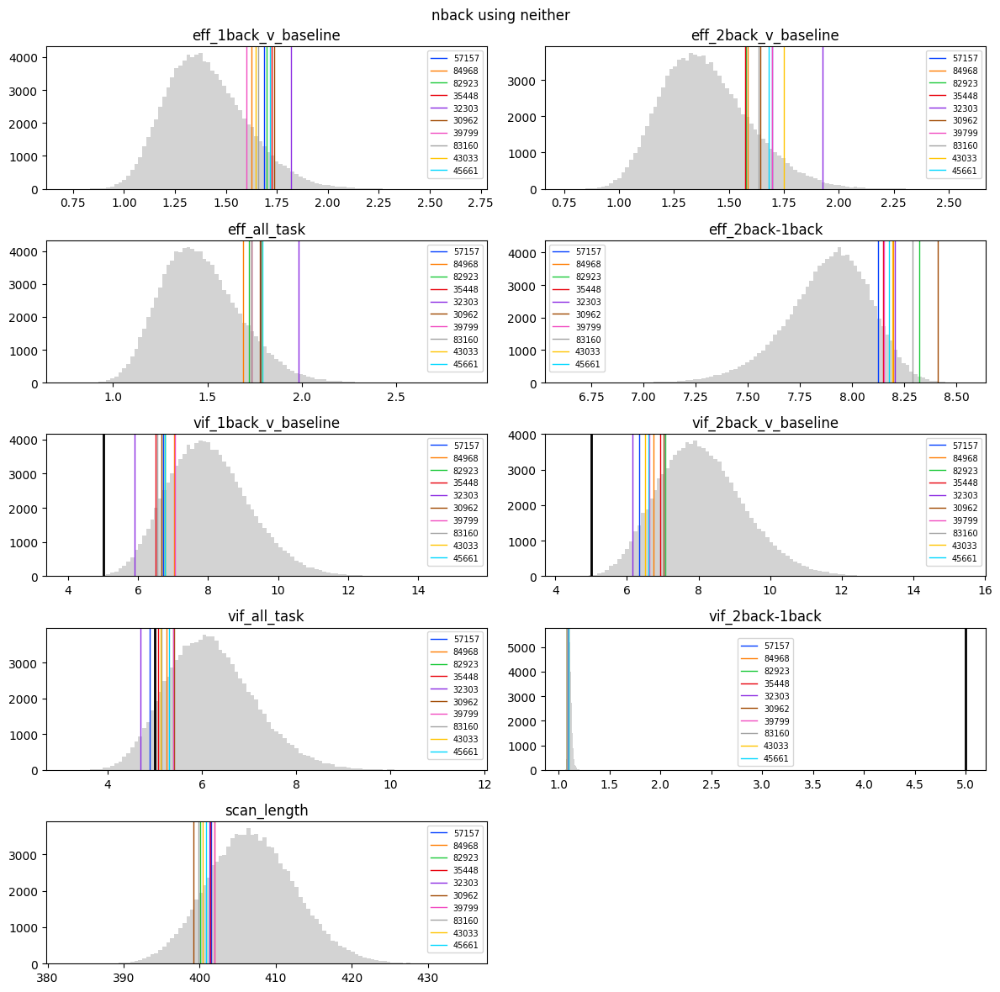

{57157, 84968, 82923, 35448, 32303, 30962, 39799, 83160, 43033, 45661}


In [37]:
task = 'nback'
base_psych_meas = ['scan_length']
choice = 'neither'
overlaps_nback = {}

overlaps_nback[choice] = choose_designs(output_nback, ranks_nback, choice, 10, task, base_psych_meas, make_grid_plot=True)


In [38]:
save_chosen_events_files('nback', output_nback, events_nback, list(overlaps_nback['neither']), root)

## Span


In [39]:
events_span, output_span, ranks_span = get_events_eff_data(outdir, 'span')

In [40]:
print(output_span.shape)

(100000, 5)


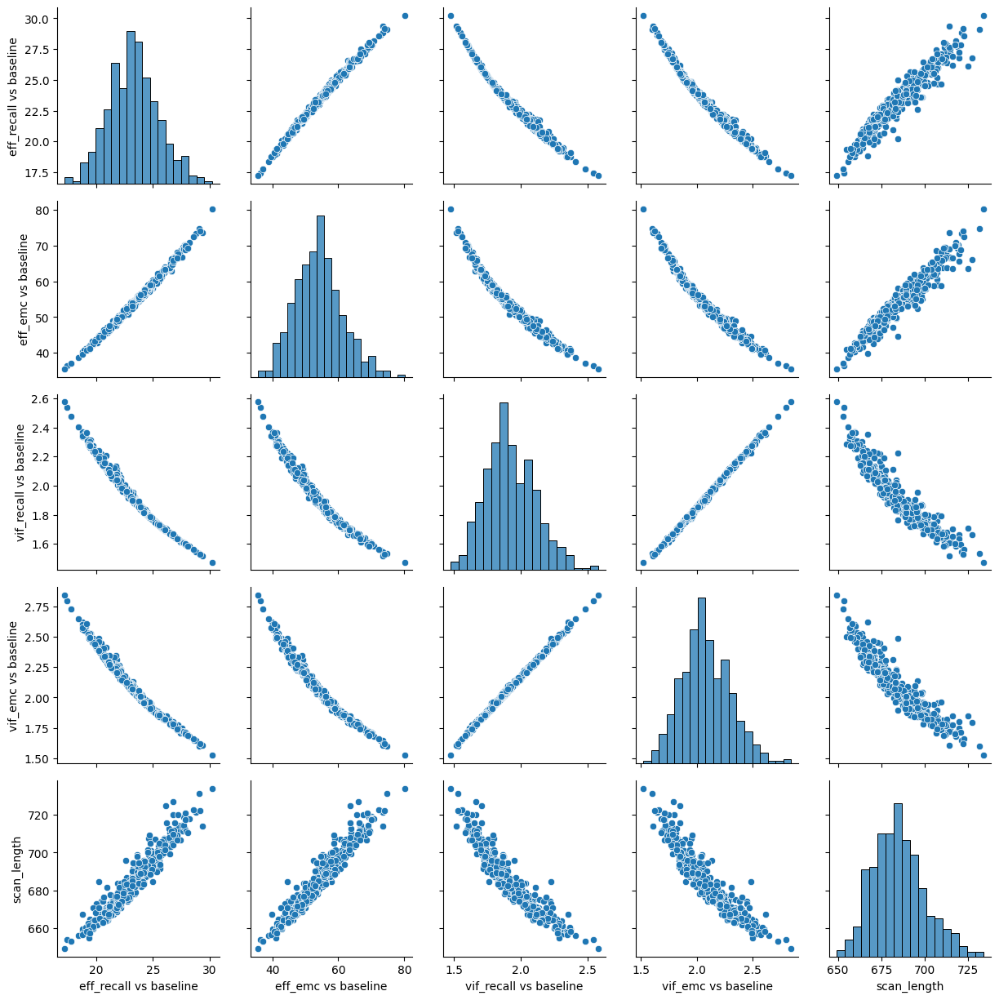

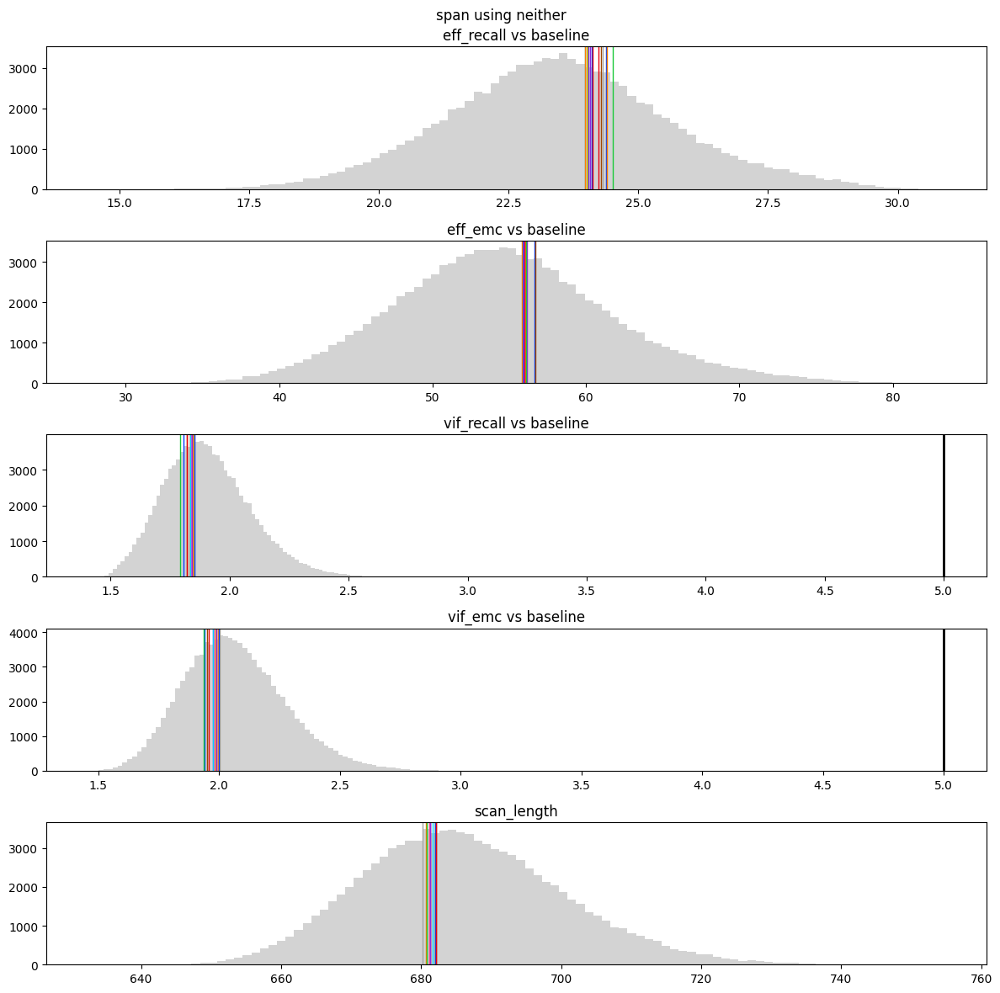

{63968, 9732, 62309, 75622, 16073, 55180, 14383, 78671, 96303, 70707, 72724, 80568, 91002, 96891, 89853}


In [41]:
task = 'span'
base_psych_meas = ['scan_length']
choice = 'neither'
overlaps_span = {}

overlaps_span[choice] = choose_designs(output_span, ranks_span, choice, 15, task, base_psych_meas, make_grid_plot=True)


In [42]:
save_chosen_events_files('span', output_span, events_span, list(overlaps_span['neither']), root)

## Spatial Cueing

In [43]:
events_spatial_cueing, output_spatial_cueing, ranks_spatial_cueing = get_events_eff_data(outdir, 'spatial_cueing')
print(output_spatial_cueing.shape)

(100000, 14)


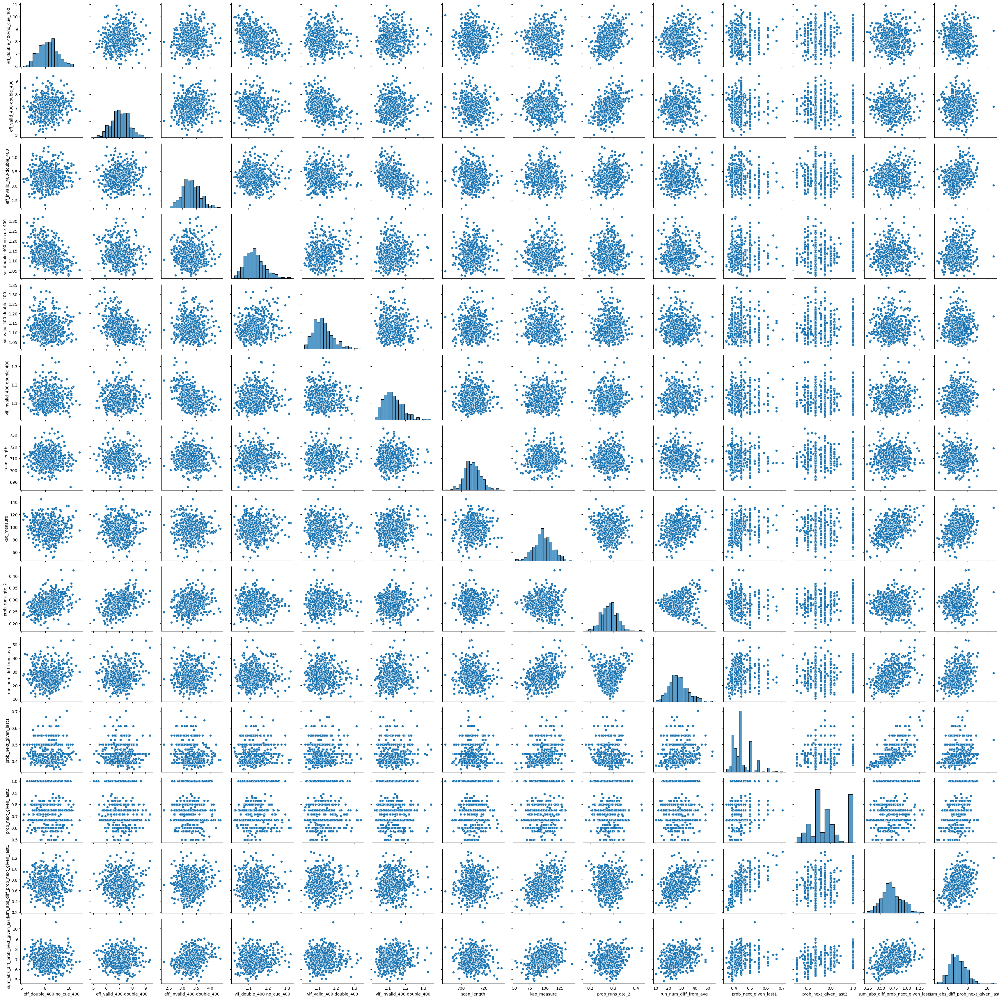

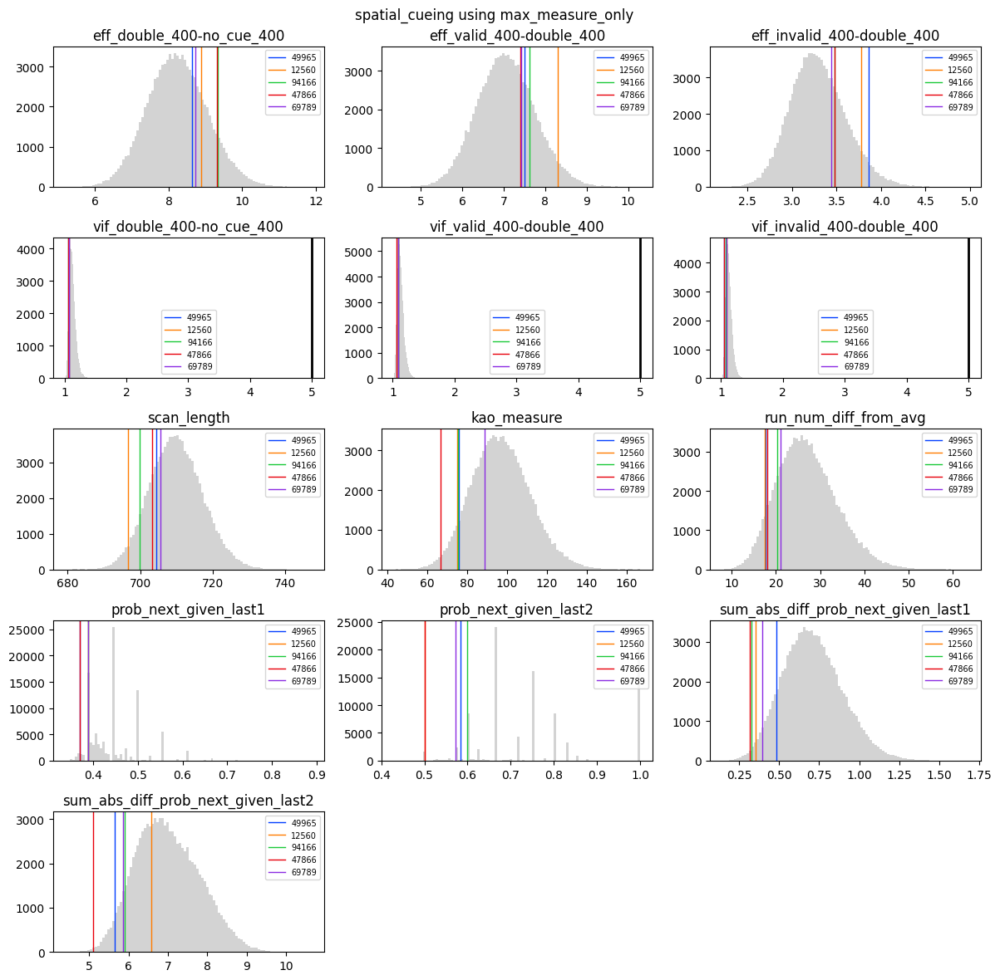

{49965, 12560, 94166, 47866, 69789}


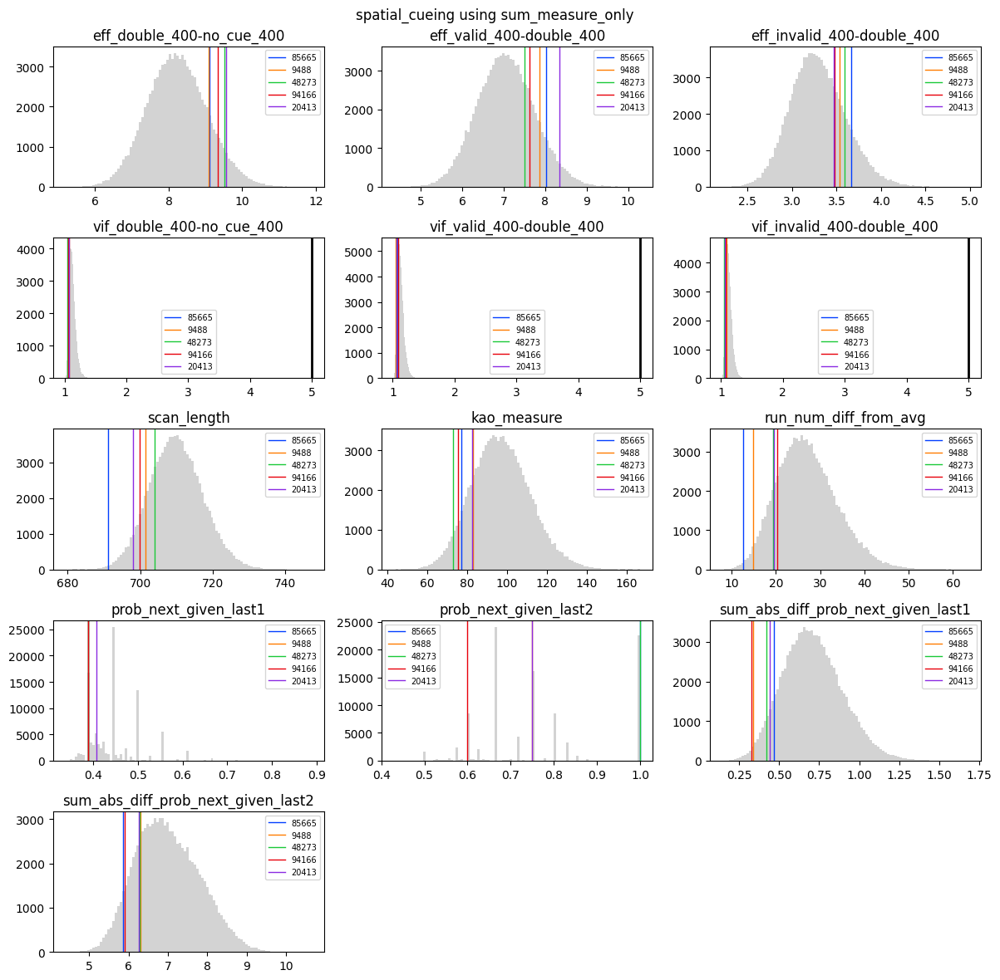

{85665, 9488, 48273, 94166, 20413}


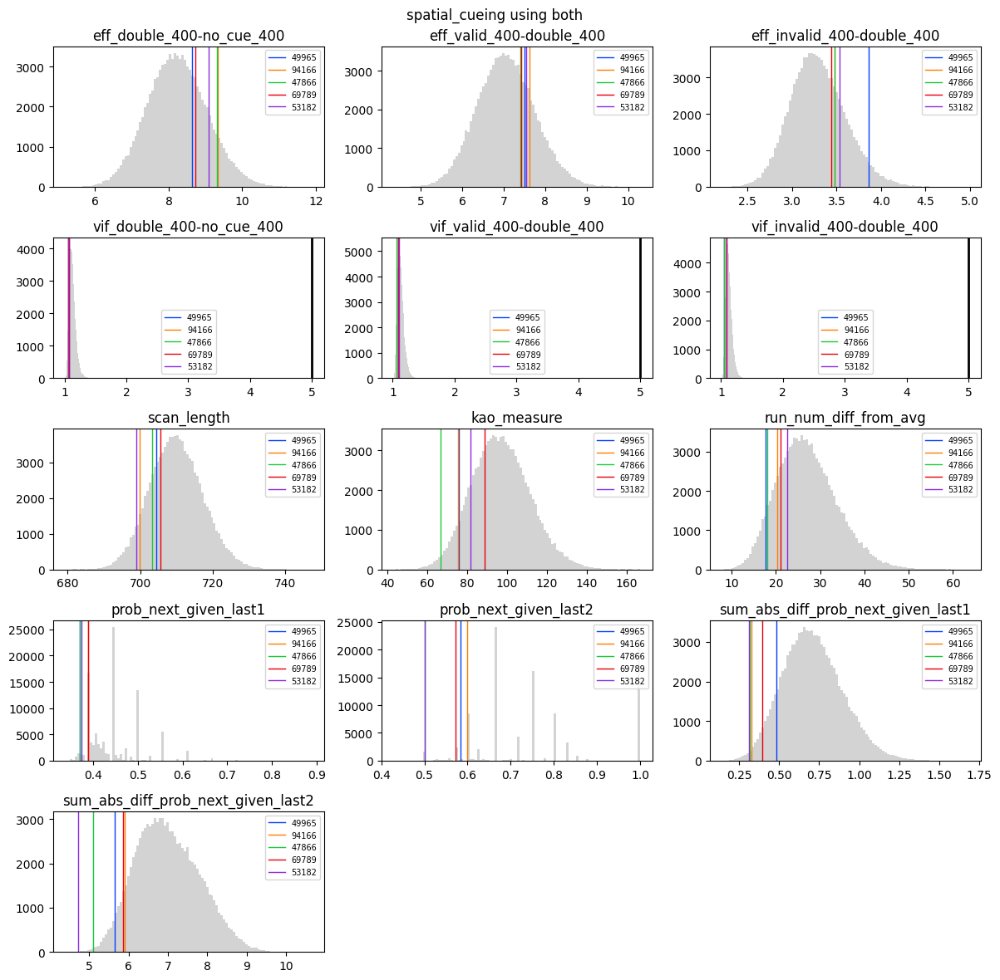

{49965, 94166, 47866, 69789, 53182}


In [44]:
task = 'spatial_cueing'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_spatial_cueing = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_spatial_cueing[choice] = choose_designs(output_spatial_cueing, ranks_spatial_cueing, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_spatial_cueing[choice] = choose_designs(output_spatial_cueing, ranks_spatial_cueing, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [45]:
save_chosen_events_files('spatial_cueing', output_spatial_cueing, events_spatial_cueing, list(overlaps_spatial_cueing['max_measure_only']), root)

## Visual Search

In [46]:
events_visual_search, output_visual_search, ranks_visual_search = get_events_eff_data(outdir, 'visual_search')
print(output_visual_search.shape)

(100000, 14)


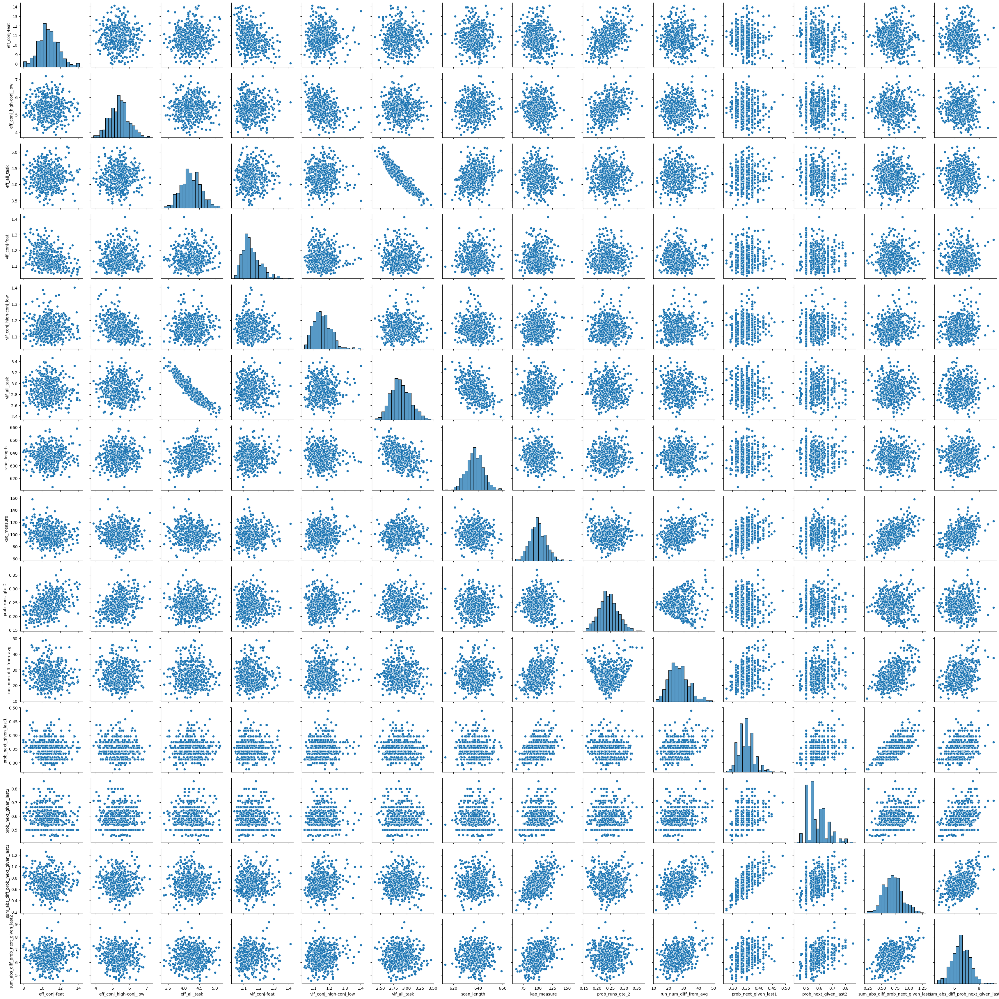

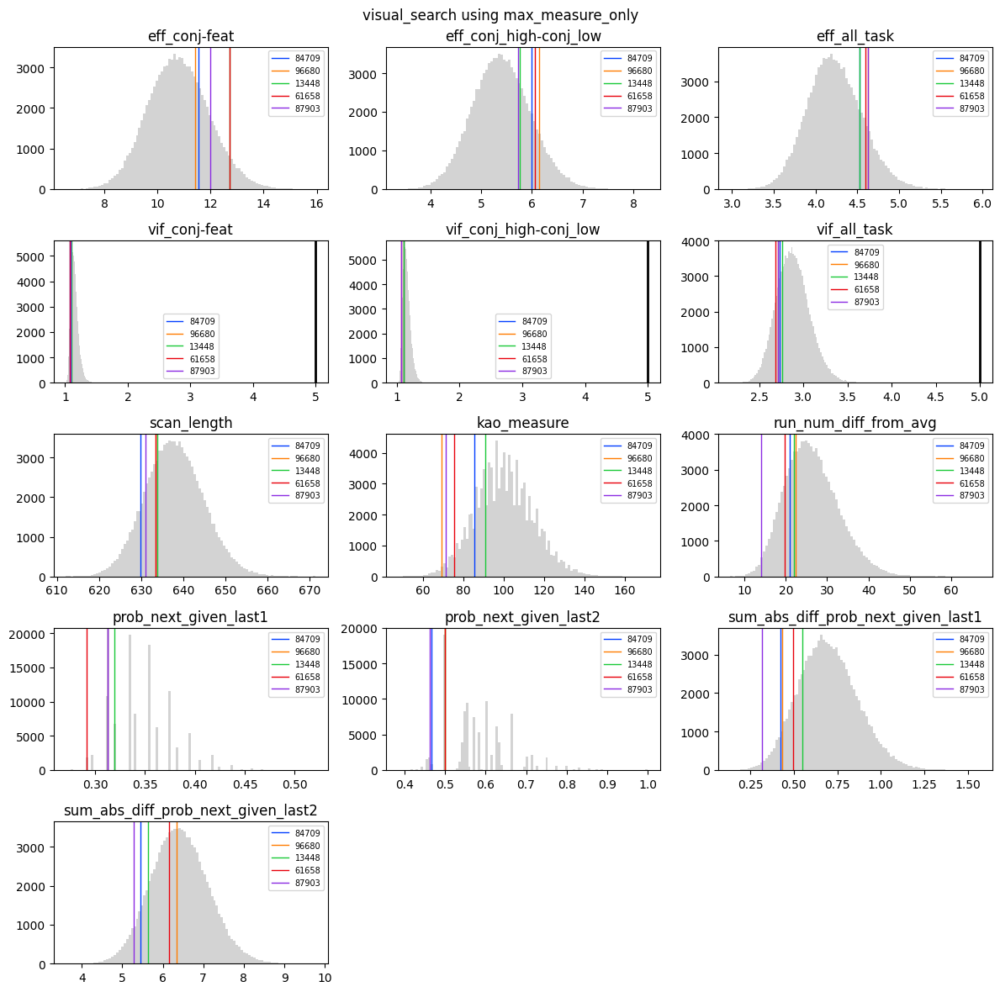

{84709, 96680, 13448, 61658, 87903}


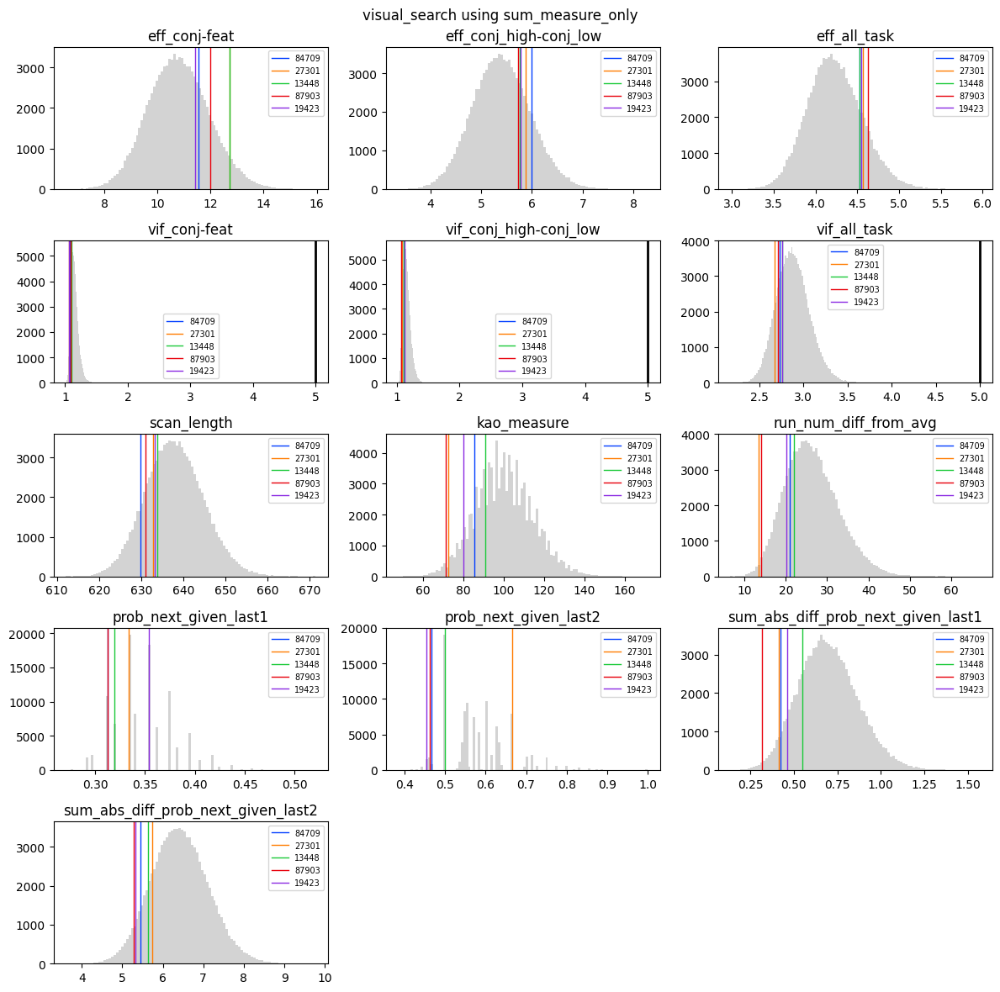

{84709, 27301, 13448, 87903, 19423}


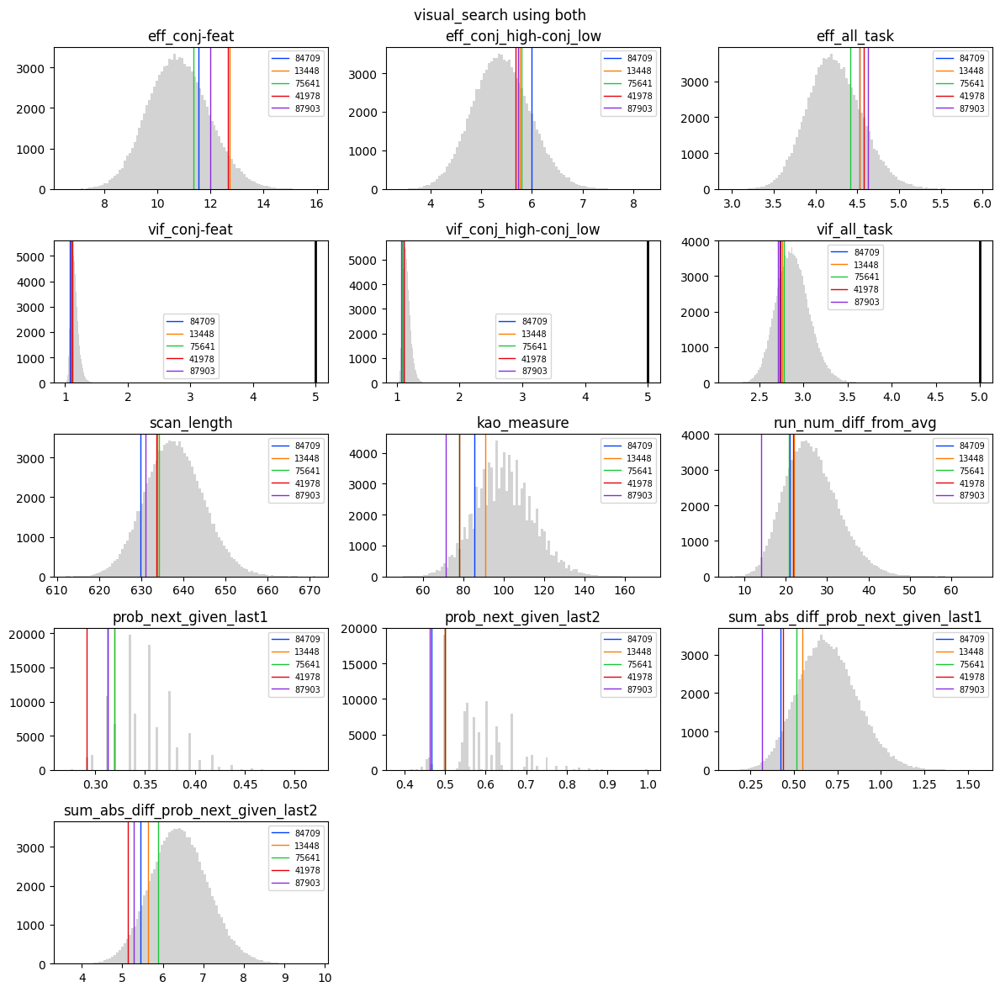

{84709, 13448, 75641, 41978, 87903}


In [47]:
task = 'visual_search'
base_psych_meas = ['scan_length', 'kao_measure', 'run_num_diff_from_avg']
choices = ['max_measure_only', 'sum_measure_only', 'both']
overlaps_visual_search = {}

for choice in choices:
    if choice == 'max_measure_only':
        overlaps_visual_search[choice] = choose_designs(output_visual_search, ranks_visual_search, choice, 5, task, base_psych_meas, make_grid_plot=True)
    else:
        overlaps_visual_search[choice] = choose_designs(output_visual_search, ranks_visual_search, choice, 5, task, base_psych_meas, make_grid_plot=False)

In [48]:
save_chosen_events_files('visual_search', output_visual_search, events_visual_search, list(overlaps_visual_search['max_measure_only']), root)